# Converting Microscopy Images with a CycleGAN


<div style="background-color: #f0f8ff; border: 2px solid #4682b4; padding: 10px;">
<a href="https://colab.research.google.com/github/noctonic/DeepLearningCrashCourse/blob/main/Ch09_GAN/ec09_C_cyclegan/cyclegan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>
<strong>If using Colab/Kaggle:</strong> You need to uncomment the code in the cell below this one.
</div>

In [1]:
!pip install deeplay  # Uncomment if using Colab/Kaggle.

This notebook provides you with a complete code example to convert between holographic and brightfield images using a CycleGAN.

<div style="background-color: #f0f8ff; border: 2px solid #4682b4; padding: 10px;">
<strong>Note:</strong> This notebook contains the Code Example 9-C from the book  

**Deep Learning Crash Course**  
Giovanni Volpe, Benjamin Midtvedt, Jesús Pineda, Henrik Klein Moberg, Harshith Bachimanchi, Joana B. Pereira, Carlo Manzo  
No Starch Press, San Francisco (CA), 2026  
ISBN-13: 9781718503922  

[https://nostarch.com/deep-learning-crash-course](https://nostarch.com/deep-learning-crash-course)

You can find the other notebooks on the [Deep Learning Crash Course GitHub page](https://github.com/DeepTrackAI/DeepLearningCrashCourse).
</div>

## Downloading and Preparing the Holo2Bright Dataset

The Holo2Bright dataset consists of holographic and brightfield microscopy images of marine microplankton. The dataset consists of 4500 holographic images and 880 brightfield images for training, and 4500 holographic images and 244 brightfield images for testing. The size of all images is 256 by 256 pixels.

Download the Holo2Bright dataset ...

In [2]:
import os

if not os.path.exists("holo2bright_dataset"):
    os.system("git clone https://github.com/DeepTrackAI/holo2bright_dataset")

... implement a Dataset object to manage the images ...

In [3]:
import numpy as np
import torch
from PIL import Image

class Holo2BrightDataset(torch.utils.data.Dataset):
    """Dataset containing the unpaired holographic and brightfield images."""

    def __init__(self, directory, transforms=None):
        """Initialize dataset."""
        self.transforms = transforms
        self.holo_dir = os.path.join(directory, "holography")
        self.holo_images = os.listdir(self.holo_dir)
        self.bright_dir = os.path.join(directory, "brightfield")
        self.bright_images = os.listdir(self.bright_dir)

    def __len__(self):
        """Return number of images."""
        return min(len(self.holo_images), len(self.bright_images))

    def __getitem__(self, index):
        """Get unpaired holographic and brightfield images."""
        holo_index = np.random.randint(len(self.holo_images))
        holo_image = Image.open(
            os.path.join(self.holo_dir, self.holo_images[holo_index])
        )
        bright_index = np.random.randint(len(self.bright_images))
        bright_image = Image.open(
            os.path.join(self.bright_dir, self.bright_images[bright_index])
        )

        if self.transforms:
            seed = np.random.randint(1_000_000_000)
            torch.manual_seed(seed)
            holo_image = self.transforms[0](holo_image)
            torch.manual_seed(seed)
            bright_image = self.transforms[1](bright_image)

        return holo_image, bright_image

... implement the necessary augmentations, transformations, and normalizations ...

In [4]:
from torchvision import transforms as trans

trans_holo = trans.Compose([
    trans.RandomHorizontalFlip(p=.5), trans.RandomVerticalFlip(p=.5),
    trans.ToTensor(), trans.Normalize(mean=[.5], std=[.5]),
])
trans_bright = trans.Compose([
    trans.RandomHorizontalFlip(p=.5), trans.RandomVerticalFlip(p=.5),
    trans.ToTensor(), trans.Normalize(mean=[.5, .5, .5], std=[.5, .5, .5]),
])

... create the training and testing datasets ...

In [5]:
train_dataset = Holo2BrightDataset(
    directory=os.path.join("holo2bright_dataset", "holo2bright", "train"),
    transforms=[trans_holo, trans_bright],
)
test_dataset = Holo2BrightDataset(
    directory=os.path.join("holo2bright_dataset", "holo2bright", "test"),
    transforms=[trans_holo, trans_bright],
)

... and plot some holographic and brightfield images.

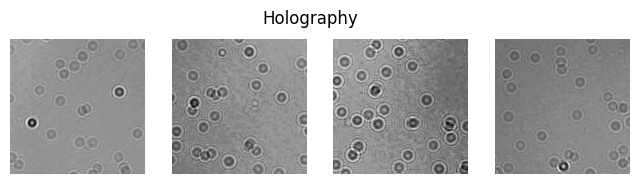

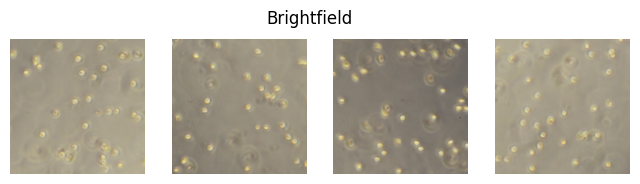

In [6]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(8, 2))
for i in range(4):
    axs[i].imshow(train_dataset[i][0][0], cmap="gray")
    axs[i].axis("off")
fig.suptitle("Holography")
plt.show()

fig, axs = plt.subplots(1, 4, figsize=(8, 2))
for i in range(4):
    img = train_dataset[i][1].permute(1, 2, 0).numpy()
    img = (((img * 0.5) + 0.5) * 255.0).astype(np.uint8)
    axs[i].imshow(img)
    axs[i].axis("off")
fig.suptitle("Brightfield")
plt.show()

## Instantiating the CycleGAN Generators and Discriminators

Determine the device to be used in the computations ...

In [7]:
def get_device():
    """Select device where to perform the computations."""
    if torch.cuda.is_available():
        return torch.device("cuda:0")
    elif torch.backends.mps.is_available():
        return torch.device("mps")
    else:
        return torch.device("cpu")

device = get_device()

print(device)

mps


... define the generators ...

In [8]:
import deeplay as dl

gen_H2B = dl.CycleGANResnetGenerator(in_channels=1, out_channels=3).build()
gen_B2H = dl.CycleGANResnetGenerator(in_channels=3, out_channels=1).build()
gen_H2B.to(device), gen_B2H.to(device);

... define the discriminators ...

In [9]:
disc_H = dl.CycleGANDiscriminator(in_channels=1).build()
disc_B = dl.CycleGANDiscriminator(in_channels=3).build()
disc_H.to(device), disc_B.to(device);

... define the loss functions ...

In [10]:
loss_gen = torch.nn.L1Loss()
loss_disc = torch.nn.MSELoss()

... define the optimizers ...

In [11]:
optim_gen = torch.optim.Adam(
    list(gen_H2B.parameters()) + list(gen_B2H.parameters()),
    lr=0.0002, betas=(0.5, 0.999),
)
optim_disc = torch.optim.Adam(
    list(disc_H.parameters()) + list(disc_B.parameters()),
    lr=0.0002, betas=(0.5, 0.999),
)

... and define the data loaders.

In [12]:
train_loader = dl.DataLoader(train_dataset, batch_size=8, shuffle=True)
test_loader = dl.DataLoader(test_dataset, batch_size=8, shuffle=False)

## Training the CycleGAN

Implement a function to train the CycleGAN ...

In [13]:
def train_model(input_images_H, input_images_B, optim_disc, optim_gen,
                loss_disc, loss_gen, cycle_coef_H=10, cycle_coef_B=5):
    """Train CycleGAN for one batch."""
    # 1. Training discriminators.
    optim_disc.zero_grad()

    # Use discriminator B (as a part of the transformation H -> B).
    fake_images_B = gen_H2B(input_images_H)
    disc_B_fakes = disc_B(fake_images_B.detach())
    disc_B_reals = disc_B(input_images_B)

    # Compute discriminator B losses.
    disc_B_loss_fake = loss_disc(disc_B_fakes, torch.zeros_like(disc_B_fakes))
    disc_B_loss_real = loss_disc(disc_B_reals, torch.ones_like(disc_B_reals))
    disc_B_loss = disc_B_loss_fake + disc_B_loss_real

    # Use discriminator H (as part of the transformaiton B -> H).
    fake_images_H = gen_B2H(input_images_B)
    disc_H_fakes = disc_H(fake_images_H.detach())
    disc_H_reals = disc_H(input_images_H)

    # Compute discriminator H losses.
    disc_H_loss_fake = loss_disc(disc_H_fakes, torch.zeros_like(disc_H_fakes))
    disc_H_loss_real = loss_disc(disc_H_reals, torch.ones_like(disc_H_reals))
    disc_H_loss = disc_H_loss_fake + disc_H_loss_real

    # Total discriminator loss, backpropagation, and weight update.
    disc_loss = (disc_B_loss + disc_H_loss) / 2
    disc_loss.backward()
    optim_disc.step()

    # 2. Training generators.
    optim_gen.zero_grad()

    # Adversarial loss (from generators perspective)
    disc_H_fakes = disc_H(fake_images_H)
    disc_B_fakes = disc_B(fake_images_B)
    gen_H2B_loss = loss_disc(disc_B_fakes, torch.ones_like(disc_B_fakes))
    gen_B2H_loss = loss_disc(disc_H_fakes, torch.ones_like(disc_H_fakes))

    # Cycle consistency loss.
    cycle_images_H = gen_B2H(fake_images_B)
    cycle_images_B = gen_H2B(fake_images_H)
    cycle_H_loss = loss_gen(input_images_H, cycle_images_H)
    cycle_B_loss = loss_gen(input_images_B, cycle_images_B)

    # Total generator loss, backpropagation, and weight update.
    gen_loss = (gen_H2B_loss + gen_B2H_loss
                + cycle_coef_H * cycle_H_loss + cycle_coef_B * cycle_B_loss)
    gen_loss.backward()
    optim_gen.step()

    return disc_loss, gen_loss
    

... implement a function to evaluate the CycleGAN ...

In [14]:
def evaluate_model(image_H, image_B):
    """Evaluate CycleGAN on unpaired holographic and brightfield images."""
    # Generate fake images.
    gen_H2B.eval(), gen_B2H.eval()
    fake_image_B, fake_image_H = gen_H2B(image_H), gen_B2H(image_B)
    gen_H2B.train(), gen_B2H.train()

    fig, axs = plt.subplots(2, 2, figsize=(5, 5))

    img_B_in = image_B[0].permute(1, 2, 0).cpu().detach().numpy()
    img_B_in = (((img_B_in * 0.5) + 0.5) * 255.0).astype(np.uint8)
    axs[0, 0].imshow(img_B_in)
    axs[0, 0].set_title("Input: Brightfield", fontsize=8)
    axs[0, 0].axis("off")

    img_H_out = fake_image_H[0].permute(1, 2, 0).cpu().detach().numpy()
    axs[0, 1].imshow(img_H_out, cmap="gray")
    axs[0, 1].set_title("Output: Holography", fontsize=8)
    axs[0, 1].axis("off")

    img_H_in = image_H[0].permute(1, 2, 0).cpu().detach().numpy()
    axs[1, 0].imshow(img_H_in, cmap="gray")
    axs[1, 0].set_title("Input: Holography", fontsize=8)
    axs[1, 0].axis("off")

    img_B_out = fake_image_B[0].permute(1, 2, 0).cpu().detach().numpy()
    img_B_out = (((img_B_out * 0.5) + 0.5) * 255.0).astype(np.uint8)
    axs[1, 1].imshow(img_B_out)
    axs[1, 1].set_title("Output: Brightfield", fontsize=8)
    axs[1, 1].axis("off")

    plt.show()
    plt.close(fig)

... and define the training cycle.


Epoch 1/100
----------
Batch 1/110 : Generators Loss: 7.7024, Discriminators Loss: 0.5339
Batch 21/110 : Generators Loss: 2.4244, Discriminators Loss: 0.1749
Batch 41/110 : Generators Loss: 2.4371, Discriminators Loss: 0.0961
Batch 61/110 : Generators Loss: 2.6264, Discriminators Loss: 0.2289
Batch 81/110 : Generators Loss: 3.0294, Discriminators Loss: 0.0124
Batch 101/110 : Generators Loss: 2.9144, Discriminators Loss: 0.0097
----------
Epoch 1/100 : Generators Loss: 2.6709, Discriminators Loss: 0.1125
Time taken: 0:38:59.737437


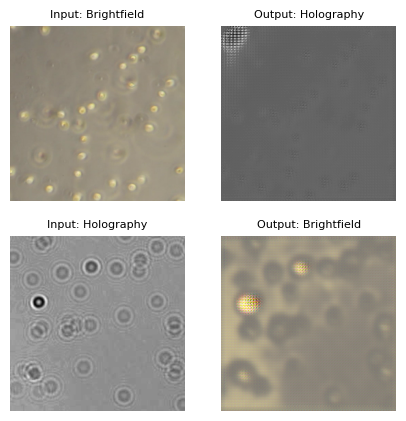


Epoch 2/100
----------
Batch 1/110 : Generators Loss: 2.7521, Discriminators Loss: 0.0054
Batch 21/110 : Generators Loss: 2.7825, Discriminators Loss: 0.0042
Batch 41/110 : Generators Loss: 2.7210, Discriminators Loss: 0.0018
Batch 61/110 : Generators Loss: 2.7571, Discriminators Loss: 0.0010
Batch 81/110 : Generators Loss: 2.6095, Discriminators Loss: 0.0013
Batch 101/110 : Generators Loss: 2.8456, Discriminators Loss: 0.0035
----------
Epoch 2/100 : Generators Loss: 2.8092, Discriminators Loss: 0.0029
Time taken: 0:06:29.077600


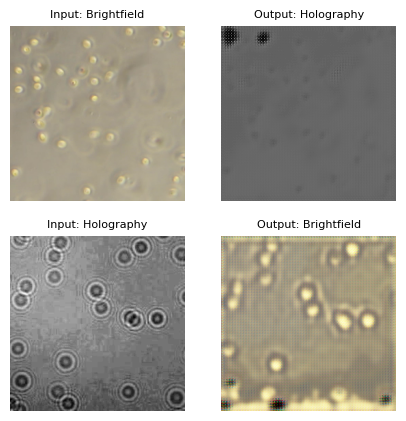


Epoch 3/100
----------
Batch 1/110 : Generators Loss: 2.6207, Discriminators Loss: 0.0090
Batch 21/110 : Generators Loss: 2.8761, Discriminators Loss: 0.0188
Batch 41/110 : Generators Loss: 2.8373, Discriminators Loss: 0.0012
Batch 61/110 : Generators Loss: 2.7911, Discriminators Loss: 0.0010
Batch 81/110 : Generators Loss: 2.0650, Discriminators Loss: 0.4857
Batch 101/110 : Generators Loss: 2.3037, Discriminators Loss: 0.3067
----------
Epoch 3/100 : Generators Loss: 2.5845, Discriminators Loss: 0.1097
Time taken: 0:06:29.458365


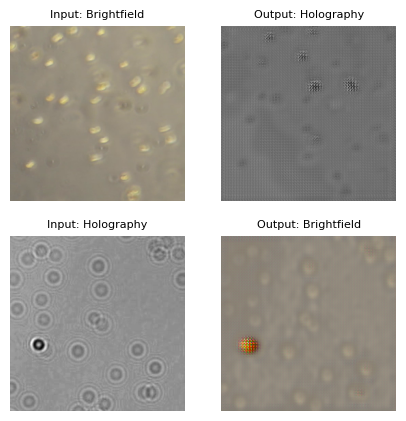


Epoch 4/100
----------
Batch 1/110 : Generators Loss: 2.5508, Discriminators Loss: 0.0578
Batch 21/110 : Generators Loss: 2.4353, Discriminators Loss: 0.3269
Batch 41/110 : Generators Loss: 2.5309, Discriminators Loss: 0.1374
Batch 61/110 : Generators Loss: 2.6956, Discriminators Loss: 0.0459
Batch 81/110 : Generators Loss: 2.0305, Discriminators Loss: 0.1967
Batch 101/110 : Generators Loss: 2.4388, Discriminators Loss: 0.2447
----------
Epoch 4/100 : Generators Loss: 2.5955, Discriminators Loss: 0.1343
Time taken: 0:06:28.583317


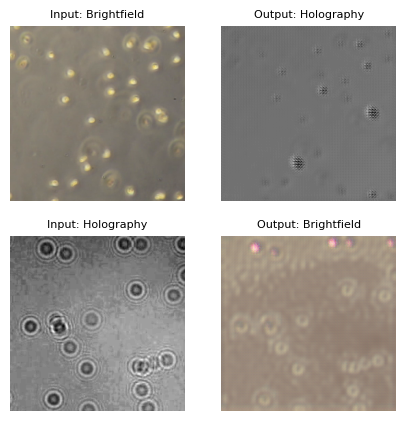


Epoch 5/100
----------
Batch 1/110 : Generators Loss: 2.6145, Discriminators Loss: 0.0655
Batch 21/110 : Generators Loss: 2.4966, Discriminators Loss: 0.3958
Batch 41/110 : Generators Loss: 2.2681, Discriminators Loss: 0.6639
Batch 61/110 : Generators Loss: 2.7339, Discriminators Loss: 0.2410
Batch 81/110 : Generators Loss: 2.7719, Discriminators Loss: 0.1658
Batch 101/110 : Generators Loss: 2.6604, Discriminators Loss: 0.2344
----------
Epoch 5/100 : Generators Loss: 2.5128, Discriminators Loss: 0.2494
Time taken: 0:06:28.449032


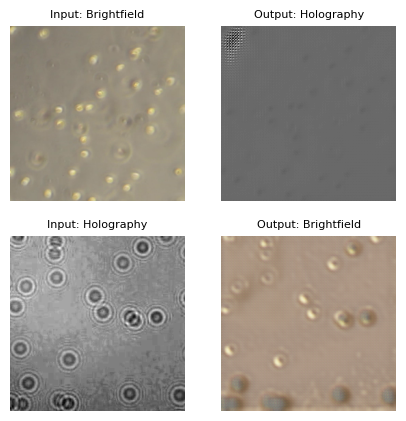


Epoch 6/100
----------
Batch 1/110 : Generators Loss: 2.3865, Discriminators Loss: 0.1094
Batch 21/110 : Generators Loss: 2.6207, Discriminators Loss: 0.1684
Batch 41/110 : Generators Loss: 2.5859, Discriminators Loss: 0.1979
Batch 61/110 : Generators Loss: 2.6269, Discriminators Loss: 0.1007
Batch 81/110 : Generators Loss: 2.5458, Discriminators Loss: 0.1400
Batch 101/110 : Generators Loss: 2.3168, Discriminators Loss: 0.2014
----------
Epoch 6/100 : Generators Loss: 2.5540, Discriminators Loss: 0.1594
Time taken: 0:06:28.626778


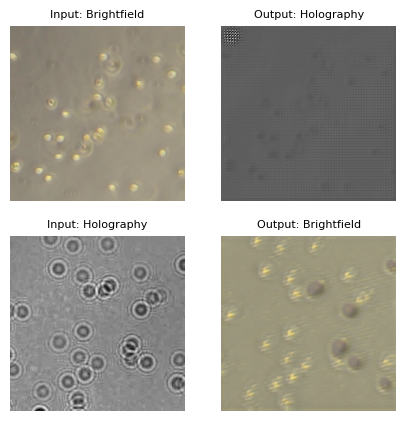


Epoch 7/100
----------
Batch 1/110 : Generators Loss: 2.7652, Discriminators Loss: 0.2274
Batch 21/110 : Generators Loss: 2.4544, Discriminators Loss: 0.0680
Batch 41/110 : Generators Loss: 2.5987, Discriminators Loss: 0.1396
Batch 61/110 : Generators Loss: 2.5706, Discriminators Loss: 0.1358
Batch 81/110 : Generators Loss: 2.4906, Discriminators Loss: 0.1288
Batch 101/110 : Generators Loss: 2.4329, Discriminators Loss: 0.1670
----------
Epoch 7/100 : Generators Loss: 2.5721, Discriminators Loss: 0.1599
Time taken: 0:06:28.733648


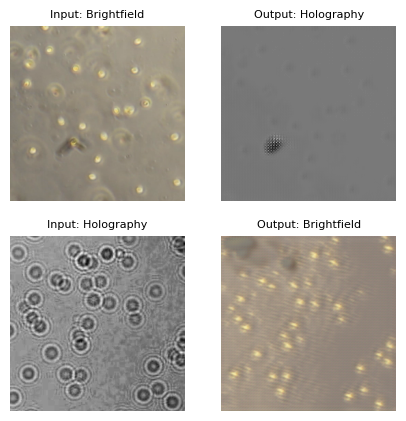


Epoch 8/100
----------
Batch 1/110 : Generators Loss: 2.5617, Discriminators Loss: 0.0622
Batch 21/110 : Generators Loss: 2.6930, Discriminators Loss: 0.1488
Batch 41/110 : Generators Loss: 2.7351, Discriminators Loss: 0.0330
Batch 61/110 : Generators Loss: 2.6988, Discriminators Loss: 0.1396
Batch 81/110 : Generators Loss: 2.5592, Discriminators Loss: 0.0176
Batch 101/110 : Generators Loss: 2.8441, Discriminators Loss: 0.0176
----------
Epoch 8/100 : Generators Loss: 2.6753, Discriminators Loss: 0.0700
Time taken: 0:06:28.409694


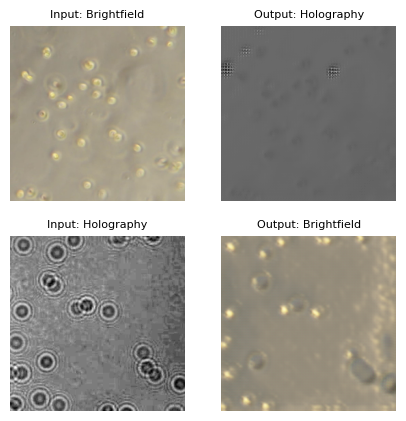


Epoch 9/100
----------
Batch 1/110 : Generators Loss: 2.8644, Discriminators Loss: 0.0174
Batch 21/110 : Generators Loss: 2.5622, Discriminators Loss: 0.0856
Batch 41/110 : Generators Loss: 2.8636, Discriminators Loss: 0.2061
Batch 61/110 : Generators Loss: 2.6318, Discriminators Loss: 0.1584
Batch 81/110 : Generators Loss: 2.7748, Discriminators Loss: 0.1342
Batch 101/110 : Generators Loss: 2.8061, Discriminators Loss: 0.1247
----------
Epoch 9/100 : Generators Loss: 2.6510, Discriminators Loss: 0.1215
Time taken: 0:06:29.037997


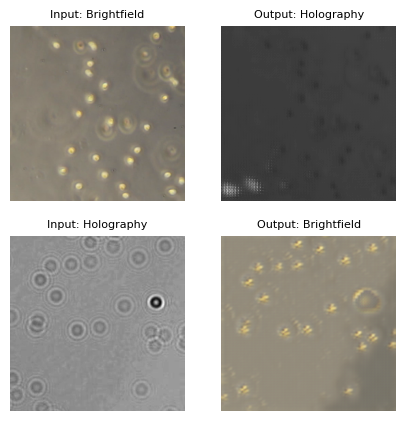


Epoch 10/100
----------
Batch 1/110 : Generators Loss: 2.4727, Discriminators Loss: 0.1198
Batch 21/110 : Generators Loss: 2.8162, Discriminators Loss: 0.0806
Batch 41/110 : Generators Loss: 2.7487, Discriminators Loss: 0.1496
Batch 61/110 : Generators Loss: 2.7911, Discriminators Loss: 0.1010
Batch 81/110 : Generators Loss: 2.7214, Discriminators Loss: 0.0424
Batch 101/110 : Generators Loss: 2.5599, Discriminators Loss: 0.0480
----------
Epoch 10/100 : Generators Loss: 2.6350, Discriminators Loss: 0.1229
Time taken: 0:06:28.748227


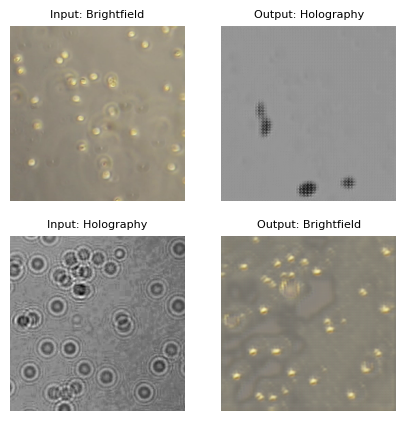


Epoch 11/100
----------
Batch 1/110 : Generators Loss: 2.9828, Discriminators Loss: 0.1730
Batch 21/110 : Generators Loss: 2.5252, Discriminators Loss: 0.0759
Batch 41/110 : Generators Loss: 2.7649, Discriminators Loss: 0.0448
Batch 61/110 : Generators Loss: 2.7153, Discriminators Loss: 0.1023
Batch 81/110 : Generators Loss: 2.4632, Discriminators Loss: 0.0865
Batch 101/110 : Generators Loss: 2.5697, Discriminators Loss: 0.1149
----------
Epoch 11/100 : Generators Loss: 2.6971, Discriminators Loss: 0.0862
Time taken: 0:06:24.565140


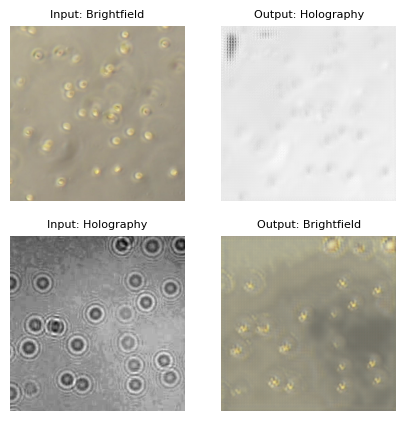


Epoch 12/100
----------
Batch 1/110 : Generators Loss: 2.7795, Discriminators Loss: 0.1422
Batch 21/110 : Generators Loss: 2.1058, Discriminators Loss: 0.6119
Batch 41/110 : Generators Loss: 2.3580, Discriminators Loss: 0.3825
Batch 61/110 : Generators Loss: 2.6645, Discriminators Loss: 0.4142
Batch 81/110 : Generators Loss: 2.6943, Discriminators Loss: 0.0721
Batch 101/110 : Generators Loss: 2.3495, Discriminators Loss: 0.3313
----------
Epoch 12/100 : Generators Loss: 2.4551, Discriminators Loss: 0.2751
Time taken: 0:06:22.436399


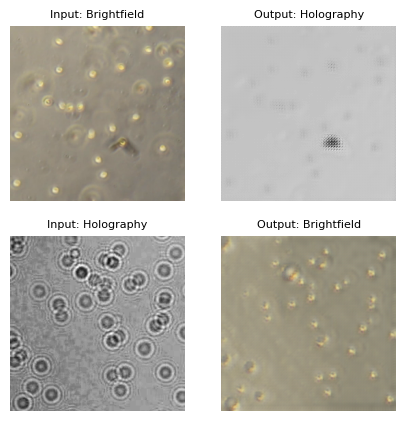


Epoch 13/100
----------
Batch 1/110 : Generators Loss: 2.7428, Discriminators Loss: 0.1272
Batch 21/110 : Generators Loss: 2.5024, Discriminators Loss: 0.0836
Batch 41/110 : Generators Loss: 2.6561, Discriminators Loss: 0.1812
Batch 61/110 : Generators Loss: 2.5347, Discriminators Loss: 0.0861
Batch 81/110 : Generators Loss: 2.4724, Discriminators Loss: 0.1587
Batch 101/110 : Generators Loss: 2.0521, Discriminators Loss: 0.0871
----------
Epoch 13/100 : Generators Loss: 2.5203, Discriminators Loss: 0.1255
Time taken: 0:06:22.517115


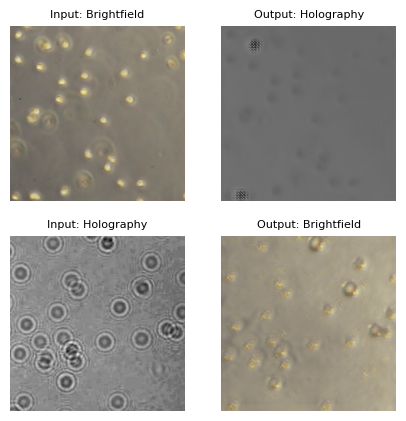


Epoch 14/100
----------
Batch 1/110 : Generators Loss: 2.3992, Discriminators Loss: 0.1136
Batch 21/110 : Generators Loss: 2.3410, Discriminators Loss: 0.1562
Batch 41/110 : Generators Loss: 1.9764, Discriminators Loss: 0.1576
Batch 61/110 : Generators Loss: 2.8319, Discriminators Loss: 0.0028
Batch 81/110 : Generators Loss: 2.5968, Discriminators Loss: 0.1317
Batch 101/110 : Generators Loss: 2.2506, Discriminators Loss: 0.1514
----------
Epoch 14/100 : Generators Loss: 2.5188, Discriminators Loss: 0.1122
Time taken: 0:06:22.584646


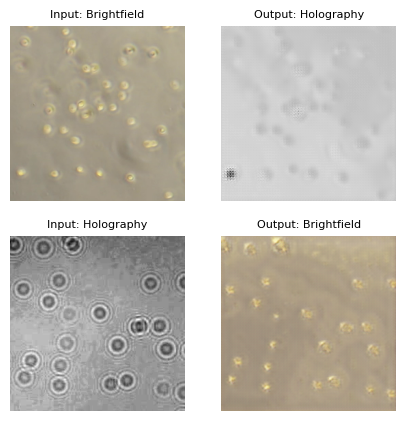


Epoch 15/100
----------
Batch 1/110 : Generators Loss: 2.6218, Discriminators Loss: 0.1296
Batch 21/110 : Generators Loss: 2.2868, Discriminators Loss: 0.0599
Batch 41/110 : Generators Loss: 2.5439, Discriminators Loss: 0.1343
Batch 61/110 : Generators Loss: 2.5365, Discriminators Loss: 0.0863
Batch 81/110 : Generators Loss: 2.6156, Discriminators Loss: 0.2089
Batch 101/110 : Generators Loss: 2.5421, Discriminators Loss: 0.0716
----------
Epoch 15/100 : Generators Loss: 2.5246, Discriminators Loss: 0.1800
Time taken: 0:06:22.740484


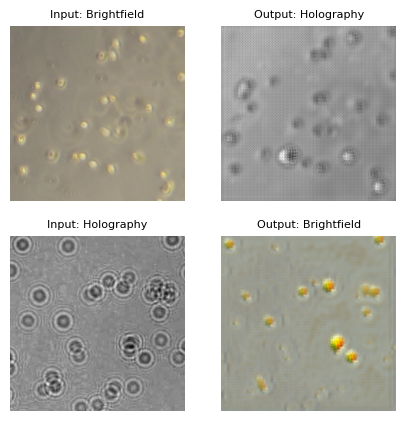


Epoch 16/100
----------
Batch 1/110 : Generators Loss: 2.9810, Discriminators Loss: 0.0137
Batch 21/110 : Generators Loss: 2.5343, Discriminators Loss: 0.0099
Batch 41/110 : Generators Loss: 2.5891, Discriminators Loss: 0.0188
Batch 61/110 : Generators Loss: 2.6087, Discriminators Loss: 0.1031
Batch 81/110 : Generators Loss: 2.5313, Discriminators Loss: 0.0149
Batch 101/110 : Generators Loss: 2.8366, Discriminators Loss: 0.0028
----------
Epoch 16/100 : Generators Loss: 2.6452, Discriminators Loss: 0.0412
Time taken: 0:06:22.825455


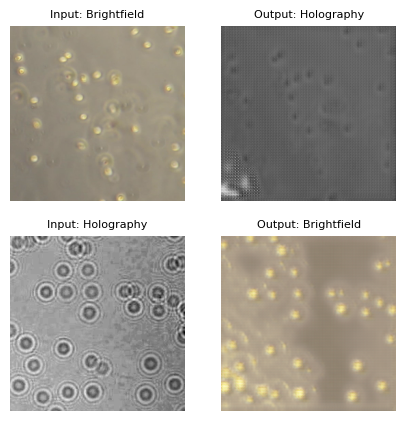


Epoch 17/100
----------
Batch 1/110 : Generators Loss: 2.8445, Discriminators Loss: 0.0078
Batch 21/110 : Generators Loss: 2.7031, Discriminators Loss: 0.0091
Batch 41/110 : Generators Loss: 2.8902, Discriminators Loss: 0.0005
Batch 61/110 : Generators Loss: 2.6523, Discriminators Loss: 0.0030
Batch 81/110 : Generators Loss: 2.9425, Discriminators Loss: 0.0011
Batch 101/110 : Generators Loss: 2.7289, Discriminators Loss: 0.0005
----------
Epoch 17/100 : Generators Loss: 2.7179, Discriminators Loss: 0.0335
Time taken: 0:06:23.012301


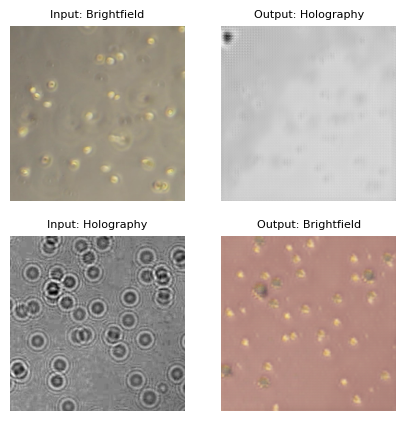


Epoch 18/100
----------
Batch 1/110 : Generators Loss: 2.7609, Discriminators Loss: 0.0004
Batch 21/110 : Generators Loss: 2.7851, Discriminators Loss: 0.0005
Batch 41/110 : Generators Loss: 2.7527, Discriminators Loss: 0.0962
Batch 61/110 : Generators Loss: 2.8896, Discriminators Loss: 0.1281
Batch 81/110 : Generators Loss: 2.6322, Discriminators Loss: 0.0725
Batch 101/110 : Generators Loss: 2.7394, Discriminators Loss: 0.0296
----------
Epoch 18/100 : Generators Loss: 2.6663, Discriminators Loss: 0.0478
Time taken: 0:06:22.862462


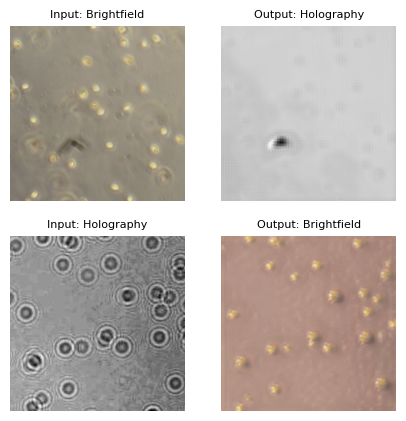


Epoch 19/100
----------
Batch 1/110 : Generators Loss: 2.7727, Discriminators Loss: 0.0004
Batch 21/110 : Generators Loss: 2.5905, Discriminators Loss: 0.0018
Batch 41/110 : Generators Loss: 2.6444, Discriminators Loss: 0.0033
Batch 61/110 : Generators Loss: 2.6314, Discriminators Loss: 0.0710
Batch 81/110 : Generators Loss: 2.3604, Discriminators Loss: 0.0631
Batch 101/110 : Generators Loss: 2.7434, Discriminators Loss: 0.0238
----------
Epoch 19/100 : Generators Loss: 2.6416, Discriminators Loss: 0.0706
Time taken: 0:06:23.445215


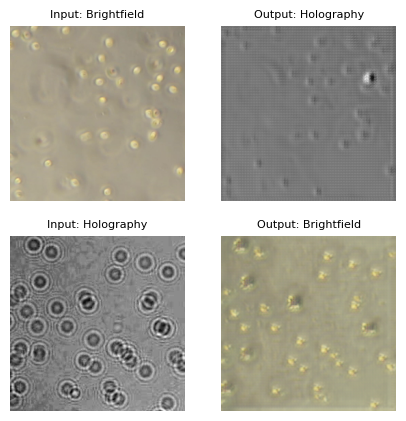


Epoch 20/100
----------
Batch 1/110 : Generators Loss: 2.7098, Discriminators Loss: 0.0027
Batch 21/110 : Generators Loss: 2.6489, Discriminators Loss: 0.0380
Batch 41/110 : Generators Loss: 2.8142, Discriminators Loss: 0.0255
Batch 61/110 : Generators Loss: 2.5054, Discriminators Loss: 0.0264
Batch 81/110 : Generators Loss: 2.7507, Discriminators Loss: 0.0005
Batch 101/110 : Generators Loss: 2.7767, Discriminators Loss: 0.0013
----------
Epoch 20/100 : Generators Loss: 2.6847, Discriminators Loss: 0.0367
Time taken: 0:06:24.235888


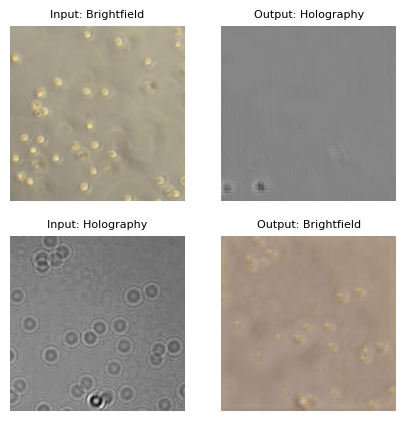


Epoch 21/100
----------
Batch 1/110 : Generators Loss: 2.7240, Discriminators Loss: 0.0007
Batch 21/110 : Generators Loss: 2.5863, Discriminators Loss: 0.0076
Batch 41/110 : Generators Loss: 2.7254, Discriminators Loss: 0.0025
Batch 61/110 : Generators Loss: 2.5765, Discriminators Loss: 0.0276
Batch 81/110 : Generators Loss: 2.6643, Discriminators Loss: 0.0032
Batch 101/110 : Generators Loss: 2.5931, Discriminators Loss: 0.0184
----------
Epoch 21/100 : Generators Loss: 2.6923, Discriminators Loss: 0.0245
Time taken: 0:06:23.721678


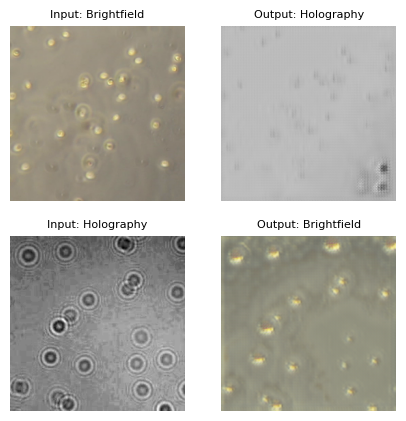


Epoch 22/100
----------
Batch 1/110 : Generators Loss: 2.7321, Discriminators Loss: 0.0012
Batch 21/110 : Generators Loss: 2.8841, Discriminators Loss: 0.0004
Batch 41/110 : Generators Loss: 2.5998, Discriminators Loss: 0.0236
Batch 61/110 : Generators Loss: 2.6170, Discriminators Loss: 0.0246
Batch 81/110 : Generators Loss: 2.5934, Discriminators Loss: 0.0118
Batch 101/110 : Generators Loss: 2.7103, Discriminators Loss: 0.0091
----------
Epoch 22/100 : Generators Loss: 2.6720, Discriminators Loss: 0.0358
Time taken: 0:06:28.837926


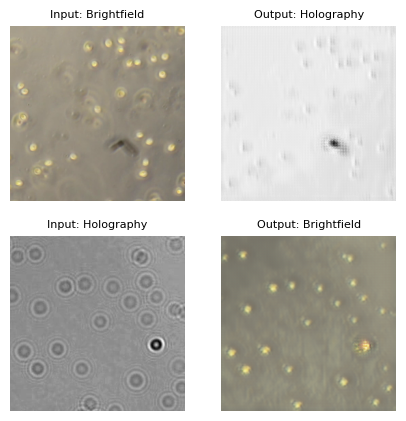


Epoch 23/100
----------
Batch 1/110 : Generators Loss: 2.7828, Discriminators Loss: 0.0225
Batch 21/110 : Generators Loss: 2.7143, Discriminators Loss: 0.0012
Batch 41/110 : Generators Loss: 2.6400, Discriminators Loss: 0.0004
Batch 61/110 : Generators Loss: 2.6580, Discriminators Loss: 0.0371
Batch 81/110 : Generators Loss: 2.7827, Discriminators Loss: 0.0001
Batch 101/110 : Generators Loss: 2.5314, Discriminators Loss: 0.0105
----------
Epoch 23/100 : Generators Loss: 2.6506, Discriminators Loss: 0.0360
Time taken: 0:06:28.809399


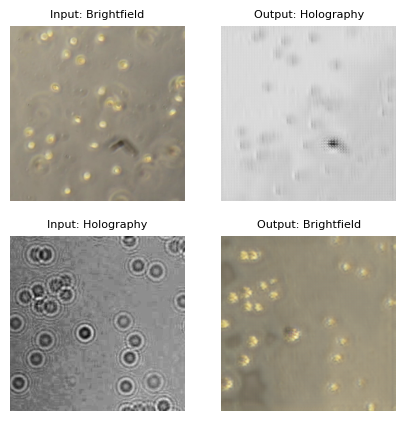


Epoch 24/100
----------
Batch 1/110 : Generators Loss: 2.6378, Discriminators Loss: 0.0205
Batch 21/110 : Generators Loss: 2.4864, Discriminators Loss: 0.0380
Batch 41/110 : Generators Loss: 2.7486, Discriminators Loss: 0.0008
Batch 61/110 : Generators Loss: 2.6375, Discriminators Loss: 0.0001
Batch 81/110 : Generators Loss: 2.6812, Discriminators Loss: 0.1436
Batch 101/110 : Generators Loss: 2.6455, Discriminators Loss: 0.0007
----------
Epoch 24/100 : Generators Loss: 2.6085, Discriminators Loss: 0.0411
Time taken: 0:06:28.902006


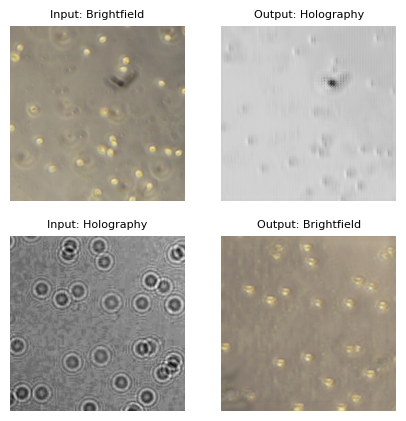


Epoch 25/100
----------
Batch 1/110 : Generators Loss: 2.5111, Discriminators Loss: 0.0249
Batch 21/110 : Generators Loss: 2.6444, Discriminators Loss: 0.0176
Batch 41/110 : Generators Loss: 2.7790, Discriminators Loss: 0.0119
Batch 61/110 : Generators Loss: 2.5076, Discriminators Loss: 0.0653
Batch 81/110 : Generators Loss: 2.5495, Discriminators Loss: 0.0105
Batch 101/110 : Generators Loss: 2.6915, Discriminators Loss: 0.0154
----------
Epoch 25/100 : Generators Loss: 2.6034, Discriminators Loss: 0.0251
Time taken: 0:06:29.055583


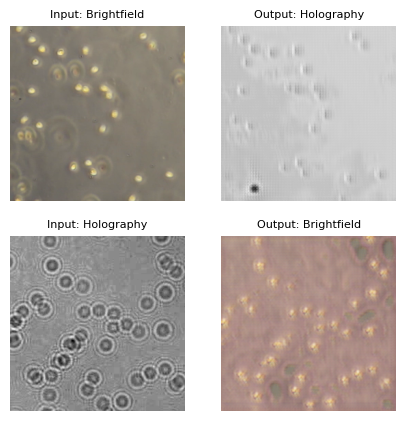


Epoch 26/100
----------
Batch 1/110 : Generators Loss: 2.7338, Discriminators Loss: 0.0003
Batch 21/110 : Generators Loss: 2.6980, Discriminators Loss: 0.0038
Batch 41/110 : Generators Loss: 2.5046, Discriminators Loss: 0.0121
Batch 61/110 : Generators Loss: 2.7200, Discriminators Loss: 0.0005
Batch 81/110 : Generators Loss: 2.6682, Discriminators Loss: 0.0010
Batch 101/110 : Generators Loss: 2.5644, Discriminators Loss: 0.0131
----------
Epoch 26/100 : Generators Loss: 2.6314, Discriminators Loss: 0.0179
Time taken: 0:06:28.797914


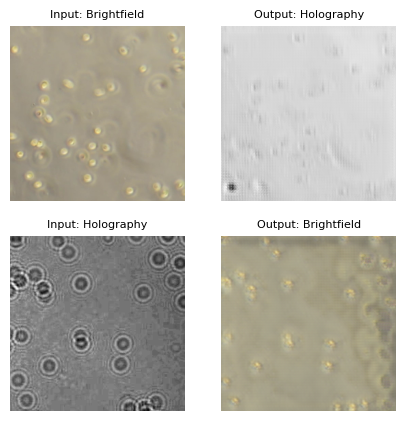


Epoch 27/100
----------
Batch 1/110 : Generators Loss: 2.4997, Discriminators Loss: 0.0134
Batch 21/110 : Generators Loss: 2.6343, Discriminators Loss: 0.0003
Batch 41/110 : Generators Loss: 2.3985, Discriminators Loss: 0.0181
Batch 61/110 : Generators Loss: 2.6323, Discriminators Loss: 0.0256
Batch 81/110 : Generators Loss: 2.6210, Discriminators Loss: 0.0228
Batch 101/110 : Generators Loss: 2.3888, Discriminators Loss: 0.0382
----------
Epoch 27/100 : Generators Loss: 2.5762, Discriminators Loss: 0.0407
Time taken: 0:06:29.464186


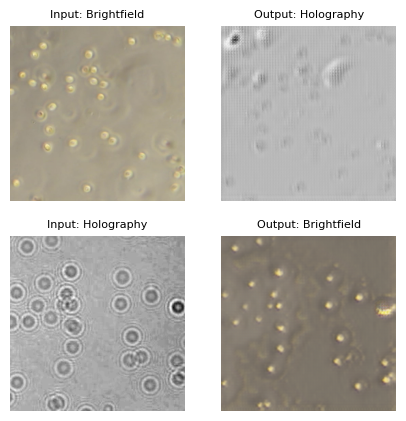


Epoch 28/100
----------
Batch 1/110 : Generators Loss: 2.5435, Discriminators Loss: 0.0485
Batch 21/110 : Generators Loss: 2.6830, Discriminators Loss: 0.0059
Batch 41/110 : Generators Loss: 2.6265, Discriminators Loss: 0.0026
Batch 61/110 : Generators Loss: 2.6534, Discriminators Loss: 0.0002
Batch 81/110 : Generators Loss: 2.6630, Discriminators Loss: 0.0006
Batch 101/110 : Generators Loss: 2.6547, Discriminators Loss: 0.0011
----------
Epoch 28/100 : Generators Loss: 2.6319, Discriminators Loss: 0.0150
Time taken: 0:06:30.654751


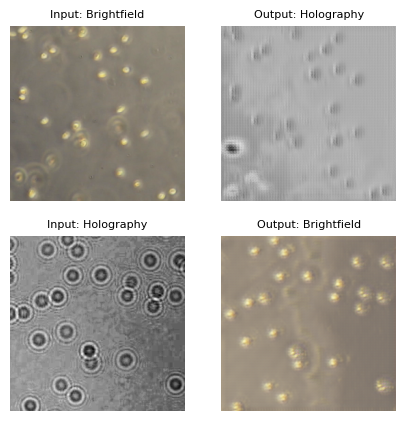


Epoch 29/100
----------
Batch 1/110 : Generators Loss: 2.8091, Discriminators Loss: 0.1658
Batch 21/110 : Generators Loss: 2.5390, Discriminators Loss: 0.0001
Batch 41/110 : Generators Loss: 2.7497, Discriminators Loss: 0.0086
Batch 61/110 : Generators Loss: 2.6423, Discriminators Loss: 0.0005
Batch 81/110 : Generators Loss: 2.7003, Discriminators Loss: 0.0001
Batch 101/110 : Generators Loss: 2.4561, Discriminators Loss: 0.0811
----------
Epoch 29/100 : Generators Loss: 2.6950, Discriminators Loss: 0.0223
Time taken: 0:06:28.521705


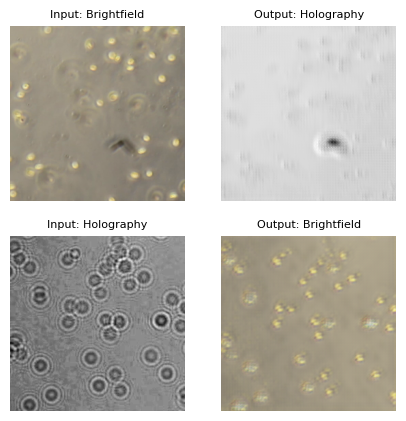


Epoch 30/100
----------
Batch 1/110 : Generators Loss: 2.6156, Discriminators Loss: 0.0237
Batch 21/110 : Generators Loss: 2.5109, Discriminators Loss: 0.0034
Batch 41/110 : Generators Loss: 2.6559, Discriminators Loss: 0.0002
Batch 61/110 : Generators Loss: 2.6511, Discriminators Loss: 0.0002
Batch 81/110 : Generators Loss: 2.5109, Discriminators Loss: 0.0749
Batch 101/110 : Generators Loss: 2.6189, Discriminators Loss: 0.0011
----------
Epoch 30/100 : Generators Loss: 2.5733, Discriminators Loss: 0.0284
Time taken: 0:06:30.057756


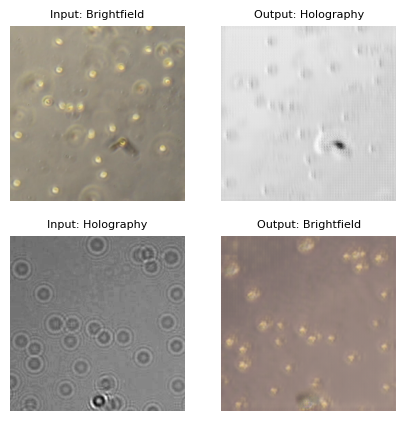


Epoch 31/100
----------
Batch 1/110 : Generators Loss: 2.5634, Discriminators Loss: 0.0010
Batch 21/110 : Generators Loss: 2.4955, Discriminators Loss: 0.0003
Batch 41/110 : Generators Loss: 2.5202, Discriminators Loss: 0.0010
Batch 61/110 : Generators Loss: 2.4017, Discriminators Loss: 0.0780
Batch 81/110 : Generators Loss: 2.6039, Discriminators Loss: 0.0554
Batch 101/110 : Generators Loss: 2.4991, Discriminators Loss: 0.0081
----------
Epoch 31/100 : Generators Loss: 2.5199, Discriminators Loss: 0.0228
Time taken: 0:06:22.149095


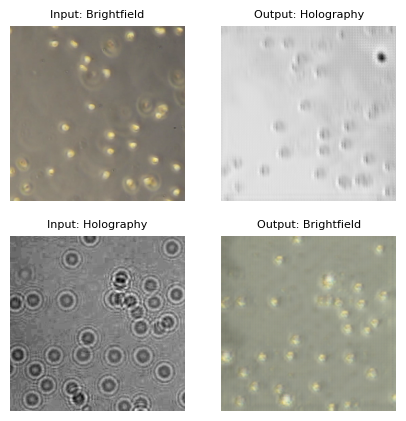


Epoch 32/100
----------
Batch 1/110 : Generators Loss: 2.4982, Discriminators Loss: 0.0004
Batch 21/110 : Generators Loss: 2.8140, Discriminators Loss: 0.0056
Batch 41/110 : Generators Loss: 2.5106, Discriminators Loss: 0.0336
Batch 61/110 : Generators Loss: 2.4524, Discriminators Loss: 0.0789
Batch 81/110 : Generators Loss: 2.5700, Discriminators Loss: 0.0854
Batch 101/110 : Generators Loss: 2.5058, Discriminators Loss: 0.0227
----------
Epoch 32/100 : Generators Loss: 2.5158, Discriminators Loss: 0.0436
Time taken: 0:06:22.421695


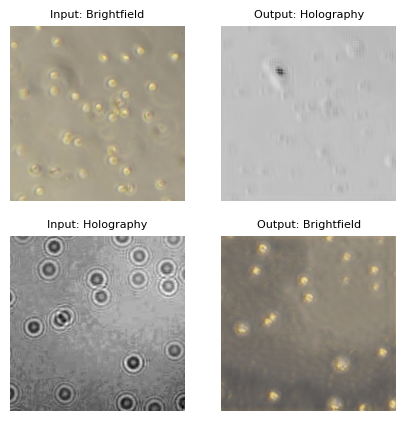


Epoch 33/100
----------
Batch 1/110 : Generators Loss: 2.4920, Discriminators Loss: 0.0684
Batch 21/110 : Generators Loss: 2.3696, Discriminators Loss: 0.0408
Batch 41/110 : Generators Loss: 2.4069, Discriminators Loss: 0.0907
Batch 61/110 : Generators Loss: 2.4847, Discriminators Loss: 0.0002
Batch 81/110 : Generators Loss: 2.5350, Discriminators Loss: 0.0087
Batch 101/110 : Generators Loss: 2.4240, Discriminators Loss: 0.0007
----------
Epoch 33/100 : Generators Loss: 2.4660, Discriminators Loss: 0.0373
Time taken: 0:06:22.398547


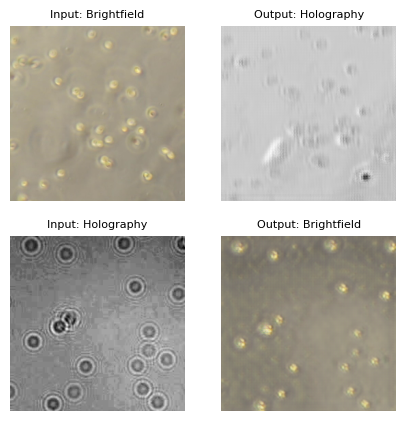


Epoch 34/100
----------
Batch 1/110 : Generators Loss: 2.2871, Discriminators Loss: 0.0195
Batch 21/110 : Generators Loss: 2.4797, Discriminators Loss: 0.0201
Batch 41/110 : Generators Loss: 2.6133, Discriminators Loss: 0.0007
Batch 61/110 : Generators Loss: 2.3643, Discriminators Loss: 0.0337
Batch 81/110 : Generators Loss: 2.4207, Discriminators Loss: 0.0025
Batch 101/110 : Generators Loss: 2.5537, Discriminators Loss: 0.3150
----------
Epoch 34/100 : Generators Loss: 2.4843, Discriminators Loss: 0.0267
Time taken: 0:06:22.400129


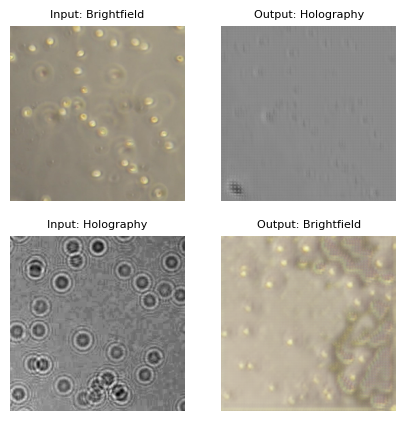


Epoch 35/100
----------
Batch 1/110 : Generators Loss: 2.6597, Discriminators Loss: 0.0006
Batch 21/110 : Generators Loss: 2.6491, Discriminators Loss: 0.0004
Batch 41/110 : Generators Loss: 2.6268, Discriminators Loss: 0.0012
Batch 61/110 : Generators Loss: 2.7138, Discriminators Loss: 0.0001
Batch 81/110 : Generators Loss: 2.4978, Discriminators Loss: 0.0004
Batch 101/110 : Generators Loss: 2.5996, Discriminators Loss: 0.0006
----------
Epoch 35/100 : Generators Loss: 2.5827, Discriminators Loss: 0.0027
Time taken: 0:06:22.389731


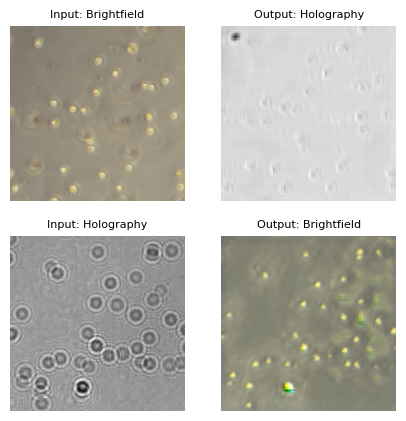


Epoch 36/100
----------
Batch 1/110 : Generators Loss: 2.5324, Discriminators Loss: 0.0004
Batch 21/110 : Generators Loss: 2.5805, Discriminators Loss: 0.0008
Batch 41/110 : Generators Loss: 2.6495, Discriminators Loss: 0.0004
Batch 61/110 : Generators Loss: 2.5011, Discriminators Loss: 0.0001
Batch 81/110 : Generators Loss: 2.6968, Discriminators Loss: 0.0000
Batch 101/110 : Generators Loss: 2.5491, Discriminators Loss: 0.0001
----------
Epoch 36/100 : Generators Loss: 2.5474, Discriminators Loss: 0.0020
Time taken: 0:06:22.437073


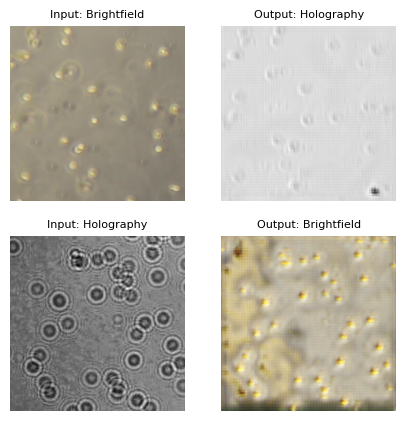


Epoch 37/100
----------
Batch 1/110 : Generators Loss: 2.5797, Discriminators Loss: 0.0002
Batch 21/110 : Generators Loss: 2.5024, Discriminators Loss: 0.0003
Batch 41/110 : Generators Loss: 2.5363, Discriminators Loss: 0.0003
Batch 61/110 : Generators Loss: 2.5922, Discriminators Loss: 0.0002
Batch 81/110 : Generators Loss: 2.5365, Discriminators Loss: 0.0009
Batch 101/110 : Generators Loss: 2.5022, Discriminators Loss: 0.0040
----------
Epoch 37/100 : Generators Loss: 2.5034, Discriminators Loss: 0.0070
Time taken: 0:06:22.384448


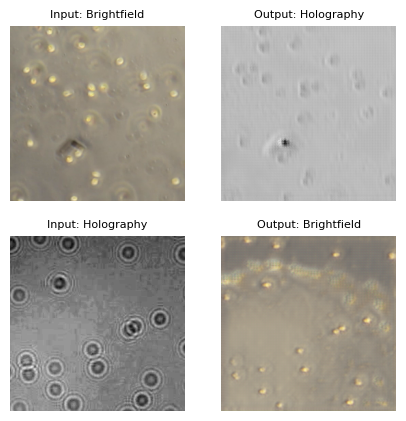


Epoch 38/100
----------
Batch 1/110 : Generators Loss: 2.5646, Discriminators Loss: 0.1248
Batch 21/110 : Generators Loss: 2.3112, Discriminators Loss: 0.0393
Batch 41/110 : Generators Loss: 2.5636, Discriminators Loss: 0.0198
Batch 61/110 : Generators Loss: 2.5415, Discriminators Loss: 0.0567
Batch 81/110 : Generators Loss: 2.6347, Discriminators Loss: 0.0003
Batch 101/110 : Generators Loss: 2.5084, Discriminators Loss: 0.0004
----------
Epoch 38/100 : Generators Loss: 2.5351, Discriminators Loss: 0.0766
Time taken: 0:06:23.859295


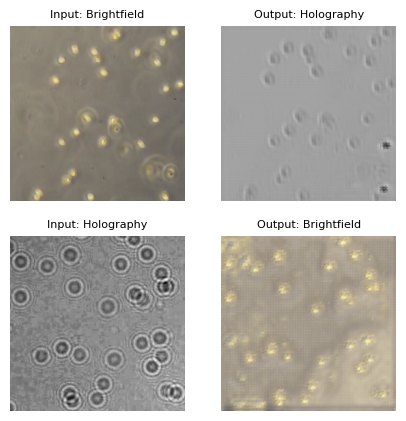


Epoch 39/100
----------
Batch 1/110 : Generators Loss: 2.4228, Discriminators Loss: 0.0130
Batch 21/110 : Generators Loss: 2.4495, Discriminators Loss: 0.0323
Batch 41/110 : Generators Loss: 2.5217, Discriminators Loss: 0.0001
Batch 61/110 : Generators Loss: 2.5007, Discriminators Loss: 0.0029
Batch 81/110 : Generators Loss: 2.5113, Discriminators Loss: 0.0083
Batch 101/110 : Generators Loss: 2.4982, Discriminators Loss: 0.0011
----------
Epoch 39/100 : Generators Loss: 2.4996, Discriminators Loss: 0.0144
Time taken: 0:06:23.670603


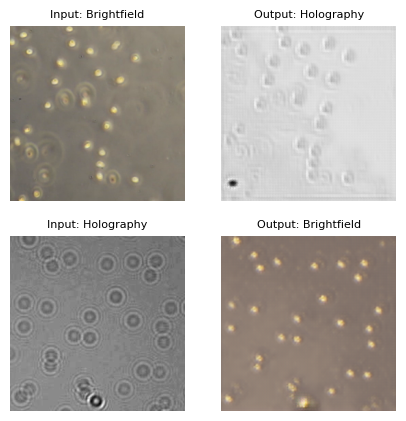


Epoch 40/100
----------
Batch 1/110 : Generators Loss: 2.4533, Discriminators Loss: 0.0046
Batch 21/110 : Generators Loss: 2.6732, Discriminators Loss: 0.0041
Batch 41/110 : Generators Loss: 2.4918, Discriminators Loss: 0.0033
Batch 61/110 : Generators Loss: 2.5207, Discriminators Loss: 0.0029
Batch 81/110 : Generators Loss: 2.3562, Discriminators Loss: 0.0150
Batch 101/110 : Generators Loss: 2.7146, Discriminators Loss: 0.1752
----------
Epoch 40/100 : Generators Loss: 2.5236, Discriminators Loss: 0.0377
Time taken: 0:06:22.515561


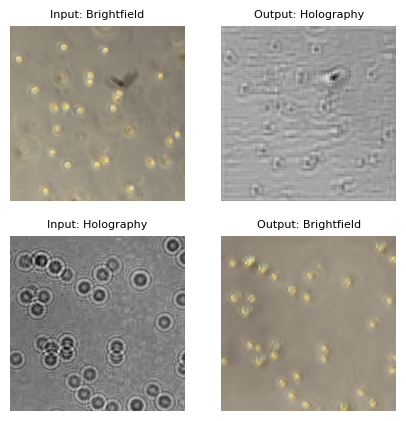


Epoch 41/100
----------
Batch 1/110 : Generators Loss: 2.5584, Discriminators Loss: 0.1065
Batch 21/110 : Generators Loss: 2.4737, Discriminators Loss: 0.1106
Batch 41/110 : Generators Loss: 2.2835, Discriminators Loss: 0.1592
Batch 61/110 : Generators Loss: 2.2472, Discriminators Loss: 0.2894
Batch 81/110 : Generators Loss: 2.6192, Discriminators Loss: 0.0842
Batch 101/110 : Generators Loss: 2.2099, Discriminators Loss: 0.2266
----------
Epoch 41/100 : Generators Loss: 2.4497, Discriminators Loss: 0.1732
Time taken: 0:06:26.192131


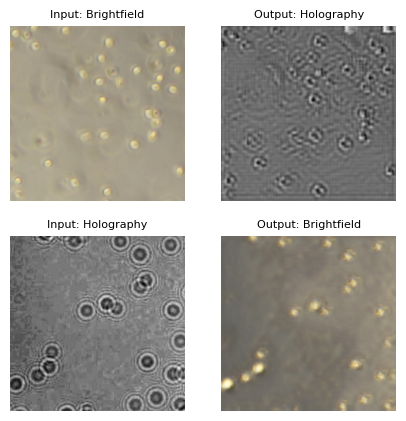


Epoch 42/100
----------
Batch 1/110 : Generators Loss: 2.2374, Discriminators Loss: 0.2744
Batch 21/110 : Generators Loss: 2.2342, Discriminators Loss: 0.1968
Batch 41/110 : Generators Loss: 2.5455, Discriminators Loss: 0.0016
Batch 61/110 : Generators Loss: 2.7009, Discriminators Loss: 0.0007
Batch 81/110 : Generators Loss: 2.4605, Discriminators Loss: 0.0042
Batch 101/110 : Generators Loss: 2.3614, Discriminators Loss: 0.0084
----------
Epoch 42/100 : Generators Loss: 2.5011, Discriminators Loss: 0.0734
Time taken: 0:06:29.374940


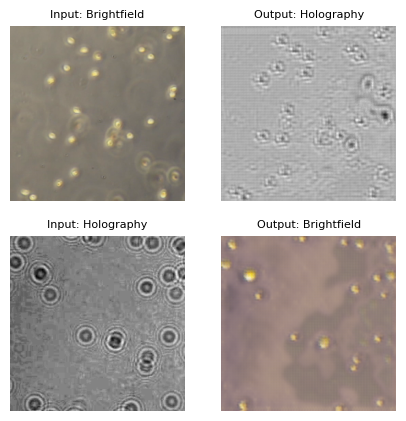


Epoch 43/100
----------
Batch 1/110 : Generators Loss: 2.9021, Discriminators Loss: 0.0095
Batch 21/110 : Generators Loss: 2.5790, Discriminators Loss: 0.0006
Batch 41/110 : Generators Loss: 2.6562, Discriminators Loss: 0.0012
Batch 61/110 : Generators Loss: 2.6561, Discriminators Loss: 0.0019
Batch 81/110 : Generators Loss: 2.3400, Discriminators Loss: 0.2711
Batch 101/110 : Generators Loss: 2.3171, Discriminators Loss: 0.1847
----------
Epoch 43/100 : Generators Loss: 2.4365, Discriminators Loss: 0.1041
Time taken: 0:06:30.552686


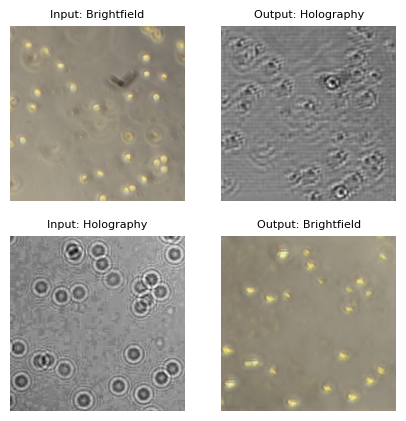


Epoch 44/100
----------
Batch 1/110 : Generators Loss: 2.1486, Discriminators Loss: 0.2063
Batch 21/110 : Generators Loss: 2.0715, Discriminators Loss: 0.2450
Batch 41/110 : Generators Loss: 2.4172, Discriminators Loss: 0.2045
Batch 61/110 : Generators Loss: 2.1838, Discriminators Loss: 0.2003
Batch 81/110 : Generators Loss: 1.8488, Discriminators Loss: 0.5858
Batch 101/110 : Generators Loss: 2.0741, Discriminators Loss: 0.1897
----------
Epoch 44/100 : Generators Loss: 2.1135, Discriminators Loss: 0.2674
Time taken: 0:06:28.686174


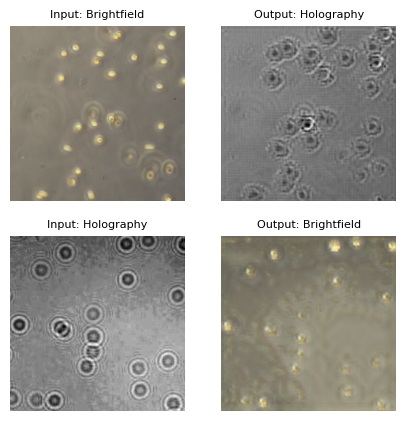


Epoch 45/100
----------
Batch 1/110 : Generators Loss: 2.1074, Discriminators Loss: 0.1975
Batch 21/110 : Generators Loss: 2.1902, Discriminators Loss: 0.1571
Batch 41/110 : Generators Loss: 2.1611, Discriminators Loss: 0.1376
Batch 61/110 : Generators Loss: 2.0712, Discriminators Loss: 0.1392
Batch 81/110 : Generators Loss: 2.1259, Discriminators Loss: 0.1819
Batch 101/110 : Generators Loss: 2.5288, Discriminators Loss: 0.1428
----------
Epoch 45/100 : Generators Loss: 2.2360, Discriminators Loss: 0.1799
Time taken: 0:06:25.591563


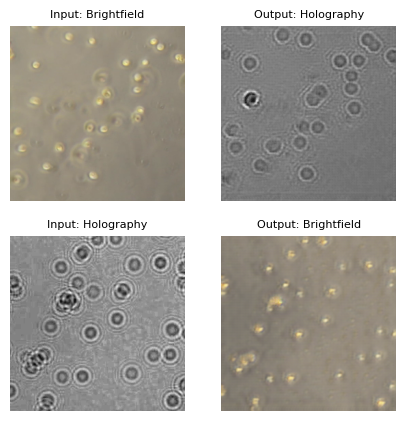


Epoch 46/100
----------
Batch 1/110 : Generators Loss: 2.0588, Discriminators Loss: 0.2236
Batch 21/110 : Generators Loss: 2.3440, Discriminators Loss: 0.2056
Batch 41/110 : Generators Loss: 2.0514, Discriminators Loss: 0.1864
Batch 61/110 : Generators Loss: 2.7818, Discriminators Loss: 0.0946
Batch 81/110 : Generators Loss: 2.1334, Discriminators Loss: 0.1738
Batch 101/110 : Generators Loss: 2.0717, Discriminators Loss: 0.1613
----------
Epoch 46/100 : Generators Loss: 2.2317, Discriminators Loss: 0.1849
Time taken: 0:06:24.248837


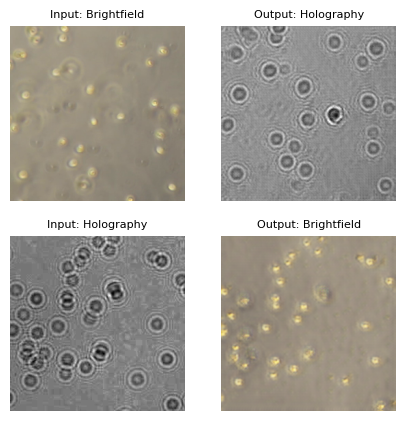


Epoch 47/100
----------
Batch 1/110 : Generators Loss: 2.0779, Discriminators Loss: 0.4626
Batch 21/110 : Generators Loss: 2.4167, Discriminators Loss: 0.3219
Batch 41/110 : Generators Loss: 2.1084, Discriminators Loss: 0.2304
Batch 61/110 : Generators Loss: 2.3089, Discriminators Loss: 0.1925
Batch 81/110 : Generators Loss: 2.1396, Discriminators Loss: 0.2630
Batch 101/110 : Generators Loss: 2.4963, Discriminators Loss: 0.1638
----------
Epoch 47/100 : Generators Loss: 2.1332, Discriminators Loss: 0.2352
Time taken: 0:06:24.136524


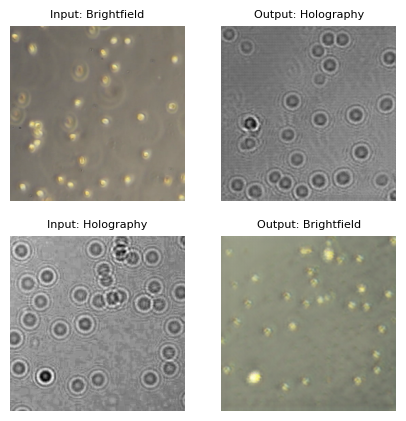


Epoch 48/100
----------
Batch 1/110 : Generators Loss: 2.1326, Discriminators Loss: 0.1749
Batch 21/110 : Generators Loss: 1.8939, Discriminators Loss: 0.1567
Batch 41/110 : Generators Loss: 2.5560, Discriminators Loss: 0.0712
Batch 61/110 : Generators Loss: 2.4668, Discriminators Loss: 0.1142
Batch 81/110 : Generators Loss: 2.2883, Discriminators Loss: 0.1016
Batch 101/110 : Generators Loss: 2.3246, Discriminators Loss: 0.0835
----------
Epoch 48/100 : Generators Loss: 2.3297, Discriminators Loss: 0.1375
Time taken: 0:06:24.129686


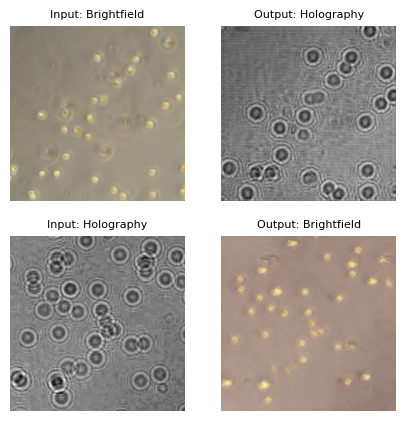


Epoch 49/100
----------
Batch 1/110 : Generators Loss: 2.3985, Discriminators Loss: 0.1055
Batch 21/110 : Generators Loss: 2.2988, Discriminators Loss: 0.0691
Batch 41/110 : Generators Loss: 2.4371, Discriminators Loss: 0.0721
Batch 61/110 : Generators Loss: 2.3963, Discriminators Loss: 0.0808
Batch 81/110 : Generators Loss: 2.5954, Discriminators Loss: 0.0134
Batch 101/110 : Generators Loss: 2.2738, Discriminators Loss: 0.0403
----------
Epoch 49/100 : Generators Loss: 2.3574, Discriminators Loss: 0.0821
Time taken: 0:06:24.043437


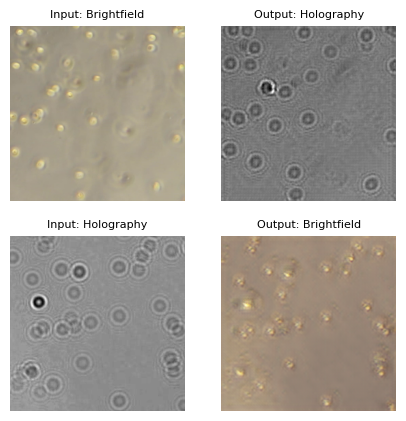


Epoch 50/100
----------
Batch 1/110 : Generators Loss: 2.3695, Discriminators Loss: 0.0504
Batch 21/110 : Generators Loss: 2.3363, Discriminators Loss: 0.0619
Batch 41/110 : Generators Loss: 2.4753, Discriminators Loss: 0.0514
Batch 61/110 : Generators Loss: 2.5177, Discriminators Loss: 0.0166
Batch 81/110 : Generators Loss: 2.4394, Discriminators Loss: 0.0340
Batch 101/110 : Generators Loss: 2.4766, Discriminators Loss: 0.0028
----------
Epoch 50/100 : Generators Loss: 2.4758, Discriminators Loss: 0.0425
Time taken: 0:06:24.021758


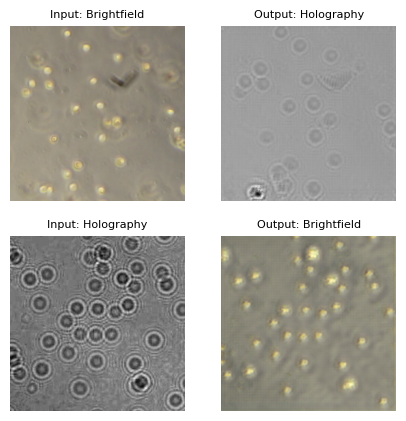


Epoch 51/100
----------
Batch 1/110 : Generators Loss: 2.4600, Discriminators Loss: 0.0075
Batch 21/110 : Generators Loss: 2.4076, Discriminators Loss: 0.0412
Batch 41/110 : Generators Loss: 2.2520, Discriminators Loss: 0.1673
Batch 61/110 : Generators Loss: 2.4015, Discriminators Loss: 0.0331
Batch 81/110 : Generators Loss: 2.3388, Discriminators Loss: 0.0437
Batch 101/110 : Generators Loss: 2.4662, Discriminators Loss: 0.0183
----------
Epoch 51/100 : Generators Loss: 2.4008, Discriminators Loss: 0.0617
Time taken: 0:06:24.021112


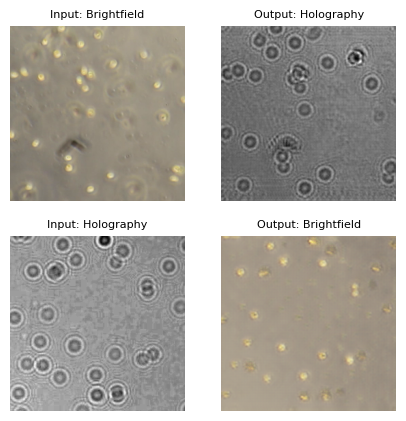


Epoch 52/100
----------
Batch 1/110 : Generators Loss: 2.3138, Discriminators Loss: 0.0549
Batch 21/110 : Generators Loss: 2.3969, Discriminators Loss: 0.0797
Batch 41/110 : Generators Loss: 2.3887, Discriminators Loss: 0.2645
Batch 61/110 : Generators Loss: 2.3075, Discriminators Loss: 0.0626
Batch 81/110 : Generators Loss: 2.3815, Discriminators Loss: 0.1251
Batch 101/110 : Generators Loss: 2.3742, Discriminators Loss: 0.0928
----------
Epoch 52/100 : Generators Loss: 2.3339, Discriminators Loss: 0.1173
Time taken: 0:06:24.136959


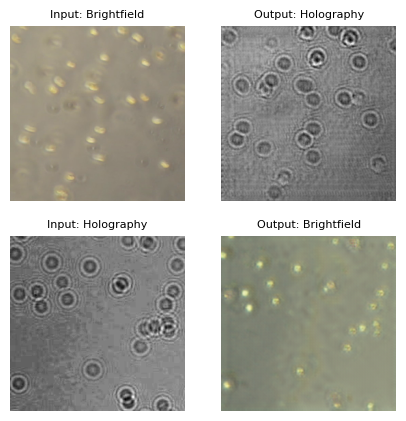


Epoch 53/100
----------
Batch 1/110 : Generators Loss: 2.3431, Discriminators Loss: 0.0558
Batch 21/110 : Generators Loss: 2.1842, Discriminators Loss: 0.1410
Batch 41/110 : Generators Loss: 2.1323, Discriminators Loss: 0.1875
Batch 61/110 : Generators Loss: 2.3325, Discriminators Loss: 0.3608
Batch 81/110 : Generators Loss: 2.2146, Discriminators Loss: 0.1549
Batch 101/110 : Generators Loss: 2.2362, Discriminators Loss: 0.2240
----------
Epoch 53/100 : Generators Loss: 2.2103, Discriminators Loss: 0.1799
Time taken: 0:06:23.984533


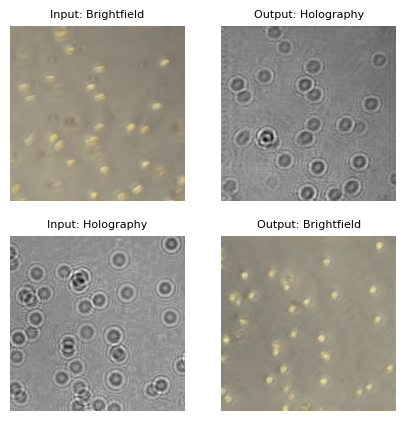


Epoch 54/100
----------
Batch 1/110 : Generators Loss: 2.1277, Discriminators Loss: 0.1551
Batch 21/110 : Generators Loss: 2.6820, Discriminators Loss: 0.1773
Batch 41/110 : Generators Loss: 2.4815, Discriminators Loss: 0.2432
Batch 61/110 : Generators Loss: 2.2949, Discriminators Loss: 0.2321
Batch 81/110 : Generators Loss: 1.8223, Discriminators Loss: 0.2278
Batch 101/110 : Generators Loss: 2.3112, Discriminators Loss: 0.1160
----------
Epoch 54/100 : Generators Loss: 2.3087, Discriminators Loss: 0.1806
Time taken: 0:06:23.727064


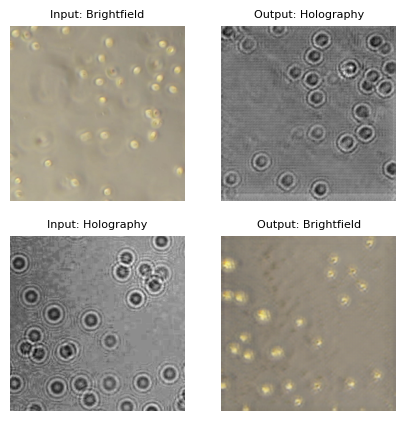


Epoch 55/100
----------
Batch 1/110 : Generators Loss: 2.7125, Discriminators Loss: 0.1682
Batch 21/110 : Generators Loss: 2.3329, Discriminators Loss: 0.1530
Batch 41/110 : Generators Loss: 2.3596, Discriminators Loss: 0.1016
Batch 61/110 : Generators Loss: 2.2623, Discriminators Loss: 0.1253
Batch 81/110 : Generators Loss: 1.9315, Discriminators Loss: 0.1863
Batch 101/110 : Generators Loss: 2.5509, Discriminators Loss: 0.0547
----------
Epoch 55/100 : Generators Loss: 2.3312, Discriminators Loss: 0.1107
Time taken: 0:06:22.155716


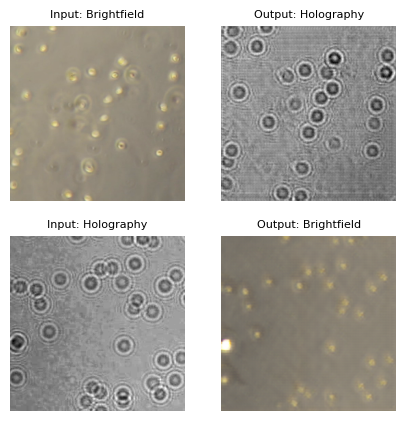


Epoch 56/100
----------
Batch 1/110 : Generators Loss: 2.3717, Discriminators Loss: 0.0730
Batch 21/110 : Generators Loss: 2.4524, Discriminators Loss: 0.1670
Batch 41/110 : Generators Loss: 2.3198, Discriminators Loss: 0.0651
Batch 61/110 : Generators Loss: 2.4568, Discriminators Loss: 0.2035
Batch 81/110 : Generators Loss: 2.2447, Discriminators Loss: 0.0873
Batch 101/110 : Generators Loss: 2.3216, Discriminators Loss: 0.0749
----------
Epoch 56/100 : Generators Loss: 2.3150, Discriminators Loss: 0.0865
Time taken: 0:06:22.354876


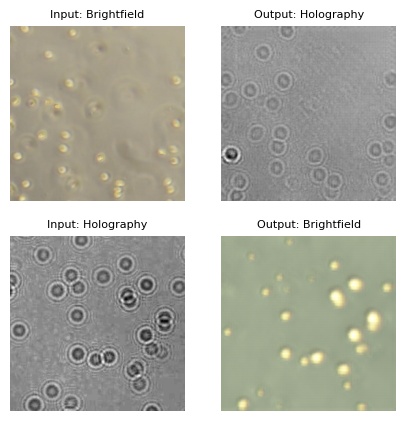


Epoch 57/100
----------
Batch 1/110 : Generators Loss: 2.5669, Discriminators Loss: 0.0265
Batch 21/110 : Generators Loss: 2.4768, Discriminators Loss: 0.0189
Batch 41/110 : Generators Loss: 2.5134, Discriminators Loss: 0.0237
Batch 61/110 : Generators Loss: 2.3999, Discriminators Loss: 0.0604
Batch 81/110 : Generators Loss: 2.3853, Discriminators Loss: 0.0307
Batch 101/110 : Generators Loss: 2.5869, Discriminators Loss: 0.0348
----------
Epoch 57/100 : Generators Loss: 2.5126, Discriminators Loss: 0.0512
Time taken: 0:06:24.222592


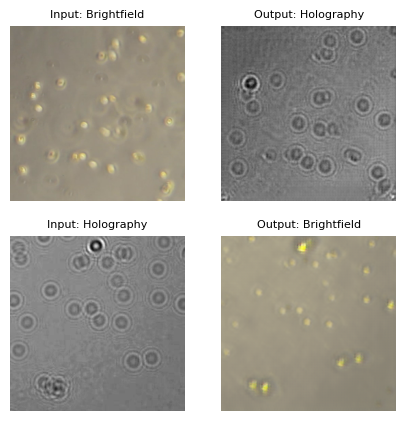


Epoch 58/100
----------
Batch 1/110 : Generators Loss: 2.4851, Discriminators Loss: 0.0353
Batch 21/110 : Generators Loss: 2.4564, Discriminators Loss: 0.0529
Batch 41/110 : Generators Loss: 2.4764, Discriminators Loss: 0.0240
Batch 61/110 : Generators Loss: 2.6020, Discriminators Loss: 0.0360
Batch 81/110 : Generators Loss: 2.4413, Discriminators Loss: 0.0533
Batch 101/110 : Generators Loss: 2.4494, Discriminators Loss: 0.1188
----------
Epoch 58/100 : Generators Loss: 2.4131, Discriminators Loss: 0.0679
Time taken: 0:06:23.194216


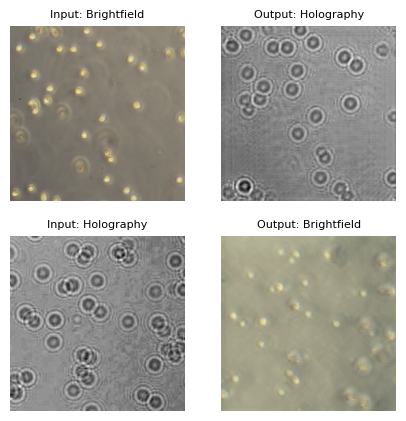


Epoch 59/100
----------
Batch 1/110 : Generators Loss: 2.3814, Discriminators Loss: 0.0885
Batch 21/110 : Generators Loss: 2.1806, Discriminators Loss: 0.1541
Batch 41/110 : Generators Loss: 2.4317, Discriminators Loss: 0.1316
Batch 61/110 : Generators Loss: 2.2317, Discriminators Loss: 0.2210
Batch 81/110 : Generators Loss: 2.2058, Discriminators Loss: 0.3719
Batch 101/110 : Generators Loss: 2.1803, Discriminators Loss: 0.2748
----------
Epoch 59/100 : Generators Loss: 2.3065, Discriminators Loss: 0.1735
Time taken: 0:06:22.609055


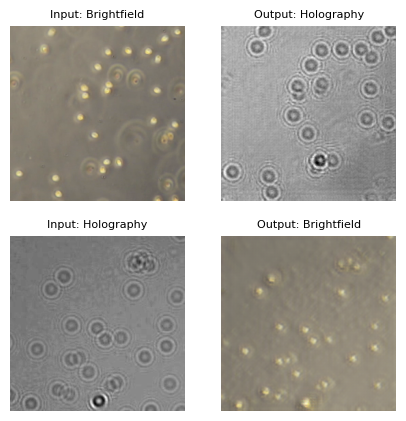


Epoch 60/100
----------
Batch 1/110 : Generators Loss: 2.2194, Discriminators Loss: 0.2520
Batch 21/110 : Generators Loss: 2.0266, Discriminators Loss: 0.2426
Batch 41/110 : Generators Loss: 2.0580, Discriminators Loss: 0.2296
Batch 61/110 : Generators Loss: 1.9636, Discriminators Loss: 0.2838
Batch 81/110 : Generators Loss: 2.2024, Discriminators Loss: 0.1863
Batch 101/110 : Generators Loss: 2.1834, Discriminators Loss: 0.2104
----------
Epoch 60/100 : Generators Loss: 2.2159, Discriminators Loss: 0.2207
Time taken: 0:06:22.645829


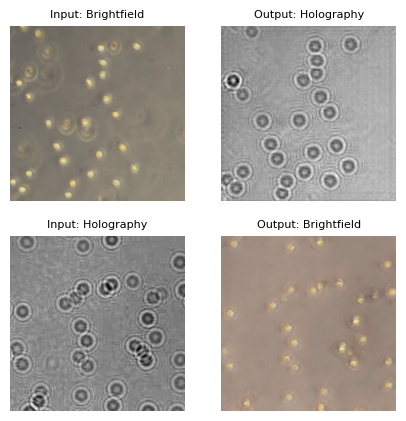


Epoch 61/100
----------
Batch 1/110 : Generators Loss: 2.1368, Discriminators Loss: 0.2570
Batch 21/110 : Generators Loss: 2.0117, Discriminators Loss: 0.2243
Batch 41/110 : Generators Loss: 2.1527, Discriminators Loss: 0.2160
Batch 61/110 : Generators Loss: 2.1990, Discriminators Loss: 0.1865
Batch 81/110 : Generators Loss: 2.2095, Discriminators Loss: 0.2499
Batch 101/110 : Generators Loss: 1.9160, Discriminators Loss: 0.1940
----------
Epoch 61/100 : Generators Loss: 2.0710, Discriminators Loss: 0.2213
Time taken: 0:06:22.527588


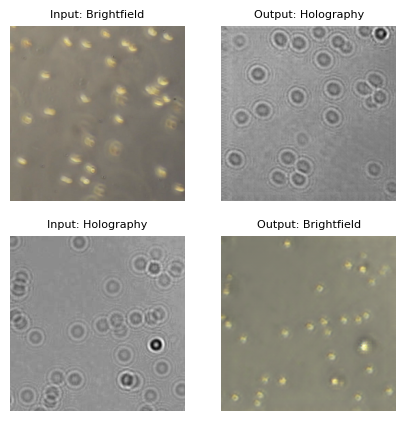


Epoch 62/100
----------
Batch 1/110 : Generators Loss: 2.0388, Discriminators Loss: 0.2121
Batch 21/110 : Generators Loss: 2.2586, Discriminators Loss: 0.2736
Batch 41/110 : Generators Loss: 2.1073, Discriminators Loss: 0.2299
Batch 61/110 : Generators Loss: 2.0609, Discriminators Loss: 0.1899
Batch 81/110 : Generators Loss: 2.2570, Discriminators Loss: 0.2100
Batch 101/110 : Generators Loss: 2.0897, Discriminators Loss: 0.1939
----------
Epoch 62/100 : Generators Loss: 2.0703, Discriminators Loss: 0.2251
Time taken: 0:06:22.481673


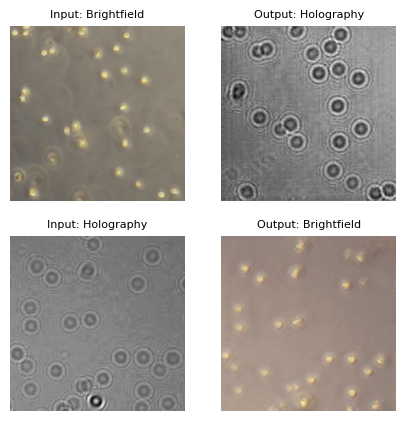


Epoch 63/100
----------
Batch 1/110 : Generators Loss: 2.1390, Discriminators Loss: 0.1930
Batch 21/110 : Generators Loss: 2.3853, Discriminators Loss: 0.2087
Batch 41/110 : Generators Loss: 2.1545, Discriminators Loss: 0.2021
Batch 61/110 : Generators Loss: 2.1044, Discriminators Loss: 0.2987
Batch 81/110 : Generators Loss: 1.8445, Discriminators Loss: 0.2357
Batch 101/110 : Generators Loss: 2.1705, Discriminators Loss: 0.2008
----------
Epoch 63/100 : Generators Loss: 2.0879, Discriminators Loss: 0.2217
Time taken: 0:06:22.495788


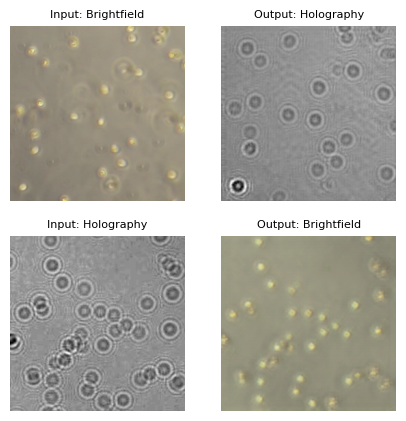


Epoch 64/100
----------
Batch 1/110 : Generators Loss: 1.9760, Discriminators Loss: 0.2006
Batch 21/110 : Generators Loss: 1.8485, Discriminators Loss: 0.2655
Batch 41/110 : Generators Loss: 1.8925, Discriminators Loss: 0.1868
Batch 61/110 : Generators Loss: 2.3909, Discriminators Loss: 0.1963
Batch 81/110 : Generators Loss: 2.1381, Discriminators Loss: 0.2021
Batch 101/110 : Generators Loss: 2.7676, Discriminators Loss: 0.0735
----------
Epoch 64/100 : Generators Loss: 2.2033, Discriminators Loss: 0.1902
Time taken: 0:06:22.654986


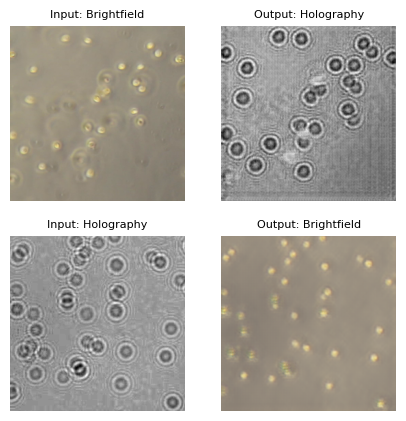


Epoch 65/100
----------
Batch 1/110 : Generators Loss: 2.2939, Discriminators Loss: 0.1857
Batch 21/110 : Generators Loss: 2.4352, Discriminators Loss: 0.1735
Batch 41/110 : Generators Loss: 2.3185, Discriminators Loss: 0.1092
Batch 61/110 : Generators Loss: 2.3440, Discriminators Loss: 0.2190
Batch 81/110 : Generators Loss: 2.2174, Discriminators Loss: 0.2040
Batch 101/110 : Generators Loss: 2.1021, Discriminators Loss: 0.2155
----------
Epoch 65/100 : Generators Loss: 2.2752, Discriminators Loss: 0.1883
Time taken: 0:06:22.079936


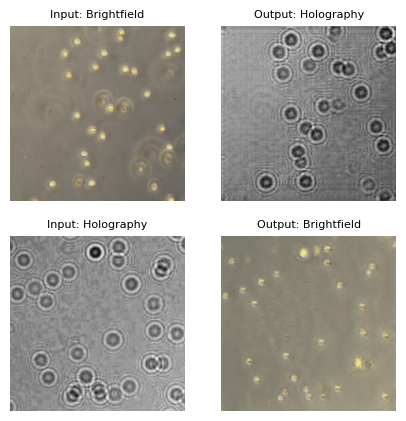


Epoch 66/100
----------
Batch 1/110 : Generators Loss: 2.2909, Discriminators Loss: 0.2134
Batch 21/110 : Generators Loss: 1.9274, Discriminators Loss: 0.1884
Batch 41/110 : Generators Loss: 1.9927, Discriminators Loss: 0.2077
Batch 61/110 : Generators Loss: 2.2751, Discriminators Loss: 0.1632
Batch 81/110 : Generators Loss: 2.0458, Discriminators Loss: 0.2315
Batch 101/110 : Generators Loss: 1.9757, Discriminators Loss: 0.2056
----------
Epoch 66/100 : Generators Loss: 2.0996, Discriminators Loss: 0.2074
Time taken: 0:06:23.602919


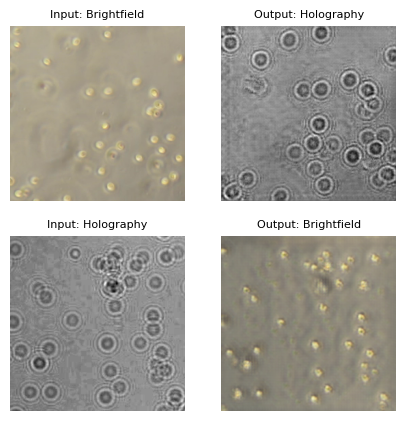


Epoch 67/100
----------
Batch 1/110 : Generators Loss: 1.9060, Discriminators Loss: 0.2129
Batch 21/110 : Generators Loss: 2.3053, Discriminators Loss: 0.2660
Batch 41/110 : Generators Loss: 2.4319, Discriminators Loss: 0.0702
Batch 61/110 : Generators Loss: 2.4250, Discriminators Loss: 0.1483
Batch 81/110 : Generators Loss: 2.3251, Discriminators Loss: 0.1757
Batch 101/110 : Generators Loss: 2.3520, Discriminators Loss: 0.1983
----------
Epoch 67/100 : Generators Loss: 2.2239, Discriminators Loss: 0.1852
Time taken: 0:06:23.911776


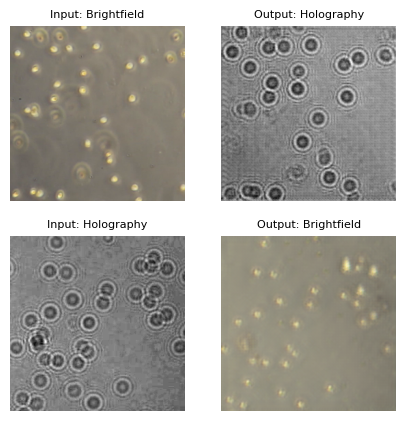


Epoch 68/100
----------
Batch 1/110 : Generators Loss: 2.0392, Discriminators Loss: 0.2222
Batch 21/110 : Generators Loss: 2.0542, Discriminators Loss: 0.2214
Batch 41/110 : Generators Loss: 1.9366, Discriminators Loss: 0.1925
Batch 61/110 : Generators Loss: 2.7954, Discriminators Loss: 0.0121
Batch 81/110 : Generators Loss: 2.8436, Discriminators Loss: 0.0072
Batch 101/110 : Generators Loss: 2.4749, Discriminators Loss: 0.0611
----------
Epoch 68/100 : Generators Loss: 2.4706, Discriminators Loss: 0.1216
Time taken: 0:06:22.745292


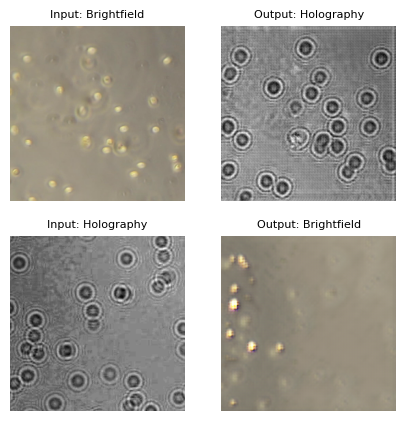


Epoch 69/100
----------
Batch 1/110 : Generators Loss: 2.5242, Discriminators Loss: 0.0987
Batch 21/110 : Generators Loss: 2.5491, Discriminators Loss: 0.1230
Batch 41/110 : Generators Loss: 2.4980, Discriminators Loss: 0.1368
Batch 61/110 : Generators Loss: 2.1782, Discriminators Loss: 0.1547
Batch 81/110 : Generators Loss: 1.9401, Discriminators Loss: 0.2347
Batch 101/110 : Generators Loss: 2.0354, Discriminators Loss: 0.1855
----------
Epoch 69/100 : Generators Loss: 2.2494, Discriminators Loss: 0.1585
Time taken: 0:06:22.634544


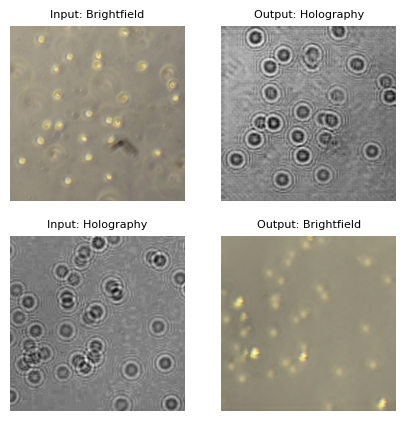


Epoch 70/100
----------
Batch 1/110 : Generators Loss: 2.2367, Discriminators Loss: 0.1799
Batch 21/110 : Generators Loss: 1.9818, Discriminators Loss: 0.2091
Batch 41/110 : Generators Loss: 2.0558, Discriminators Loss: 0.1653
Batch 61/110 : Generators Loss: 2.0848, Discriminators Loss: 0.1494
Batch 81/110 : Generators Loss: 1.8745, Discriminators Loss: 0.2482
Batch 101/110 : Generators Loss: 2.1473, Discriminators Loss: 0.2397
----------
Epoch 70/100 : Generators Loss: 2.0696, Discriminators Loss: 0.1898
Time taken: 0:06:22.624015


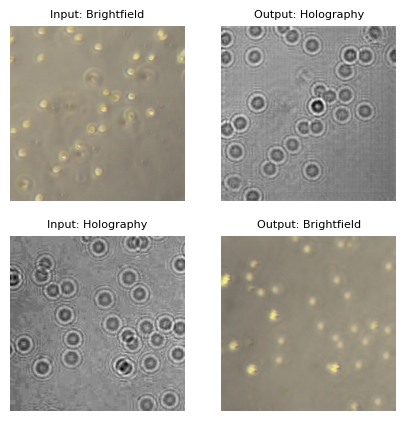


Epoch 71/100
----------
Batch 1/110 : Generators Loss: 2.0194, Discriminators Loss: 0.2125
Batch 21/110 : Generators Loss: 2.0143, Discriminators Loss: 0.2508
Batch 41/110 : Generators Loss: 2.3577, Discriminators Loss: 0.1736
Batch 61/110 : Generators Loss: 2.0710, Discriminators Loss: 0.2280
Batch 81/110 : Generators Loss: 2.0588, Discriminators Loss: 0.2215
Batch 101/110 : Generators Loss: 2.0235, Discriminators Loss: 0.1365
----------
Epoch 71/100 : Generators Loss: 2.0569, Discriminators Loss: 0.2032
Time taken: 0:06:22.576934


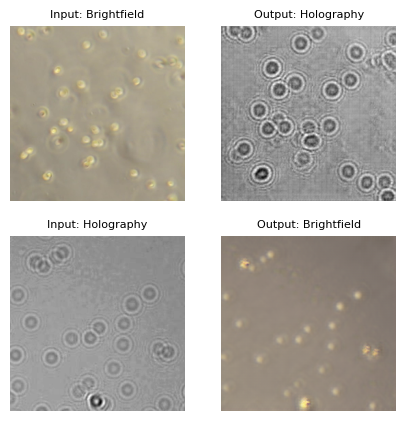


Epoch 72/100
----------
Batch 1/110 : Generators Loss: 1.9672, Discriminators Loss: 0.2046
Batch 21/110 : Generators Loss: 1.9159, Discriminators Loss: 0.1756
Batch 41/110 : Generators Loss: 1.9506, Discriminators Loss: 0.2094
Batch 61/110 : Generators Loss: 2.0218, Discriminators Loss: 0.1687
Batch 81/110 : Generators Loss: 1.9053, Discriminators Loss: 0.2135
Batch 101/110 : Generators Loss: 2.0082, Discriminators Loss: 0.2696
----------
Epoch 72/100 : Generators Loss: 2.0039, Discriminators Loss: 0.2156
Time taken: 0:06:22.494387


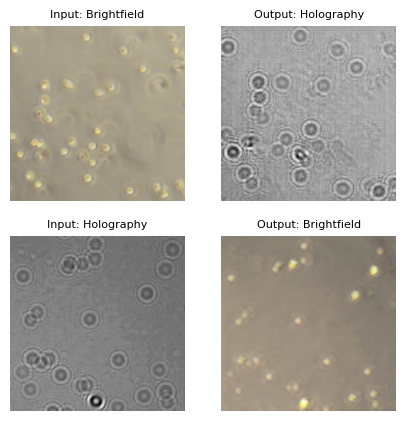


Epoch 73/100
----------
Batch 1/110 : Generators Loss: 2.0205, Discriminators Loss: 0.1607
Batch 21/110 : Generators Loss: 1.9191, Discriminators Loss: 0.3551
Batch 41/110 : Generators Loss: 1.9447, Discriminators Loss: 0.3102
Batch 61/110 : Generators Loss: 1.7958, Discriminators Loss: 0.2484
Batch 81/110 : Generators Loss: 1.8445, Discriminators Loss: 0.2121
Batch 101/110 : Generators Loss: 1.8681, Discriminators Loss: 0.2148
----------
Epoch 73/100 : Generators Loss: 1.9607, Discriminators Loss: 0.2162
Time taken: 0:06:22.662115


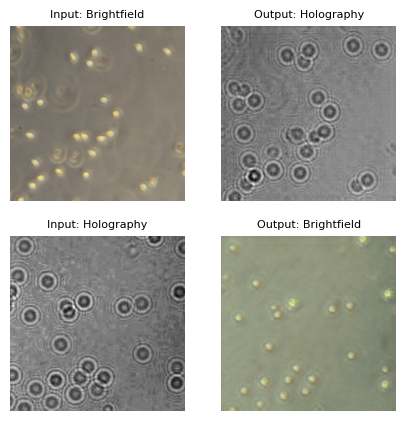


Epoch 74/100
----------
Batch 1/110 : Generators Loss: 1.9658, Discriminators Loss: 0.2275
Batch 21/110 : Generators Loss: 2.1197, Discriminators Loss: 0.1758
Batch 41/110 : Generators Loss: 1.8636, Discriminators Loss: 0.2003
Batch 61/110 : Generators Loss: 1.9302, Discriminators Loss: 0.2167
Batch 81/110 : Generators Loss: 1.8721, Discriminators Loss: 0.2629
Batch 101/110 : Generators Loss: 2.0156, Discriminators Loss: 0.1728
----------
Epoch 74/100 : Generators Loss: 1.9908, Discriminators Loss: 0.2204
Time taken: 0:06:22.104795


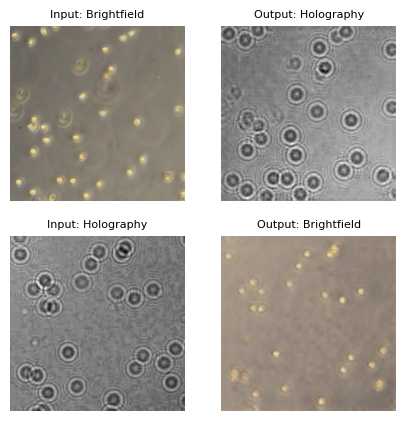


Epoch 75/100
----------
Batch 1/110 : Generators Loss: 1.8532, Discriminators Loss: 0.2252
Batch 21/110 : Generators Loss: 1.8326, Discriminators Loss: 0.1862
Batch 41/110 : Generators Loss: 1.9785, Discriminators Loss: 0.1978
Batch 61/110 : Generators Loss: 1.8810, Discriminators Loss: 0.2319
Batch 81/110 : Generators Loss: 1.8726, Discriminators Loss: 0.1976
Batch 101/110 : Generators Loss: 2.0539, Discriminators Loss: 0.2901
----------
Epoch 75/100 : Generators Loss: 1.9176, Discriminators Loss: 0.2257
Time taken: 0:06:23.023383


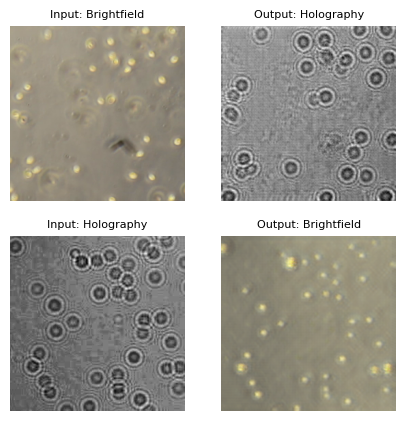


Epoch 76/100
----------
Batch 1/110 : Generators Loss: 1.9067, Discriminators Loss: 0.1898
Batch 21/110 : Generators Loss: 1.8853, Discriminators Loss: 0.2318
Batch 41/110 : Generators Loss: 1.9391, Discriminators Loss: 0.1926
Batch 61/110 : Generators Loss: 2.0108, Discriminators Loss: 0.3887
Batch 81/110 : Generators Loss: 2.0333, Discriminators Loss: 0.1652
Batch 101/110 : Generators Loss: 1.9241, Discriminators Loss: 0.2363
----------
Epoch 76/100 : Generators Loss: 2.0287, Discriminators Loss: 0.2127
Time taken: 0:06:24.480546


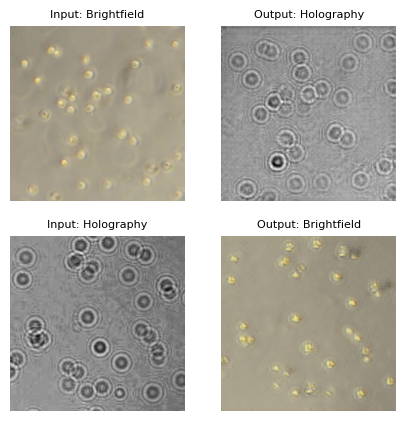


Epoch 77/100
----------
Batch 1/110 : Generators Loss: 2.1697, Discriminators Loss: 0.2143
Batch 21/110 : Generators Loss: 1.7104, Discriminators Loss: 0.3035
Batch 41/110 : Generators Loss: 1.8691, Discriminators Loss: 0.2463
Batch 61/110 : Generators Loss: 1.9724, Discriminators Loss: 0.2507
Batch 81/110 : Generators Loss: 1.9681, Discriminators Loss: 0.1769
Batch 101/110 : Generators Loss: 1.7615, Discriminators Loss: 0.2179
----------
Epoch 77/100 : Generators Loss: 1.9754, Discriminators Loss: 0.2436
Time taken: 0:06:22.964652


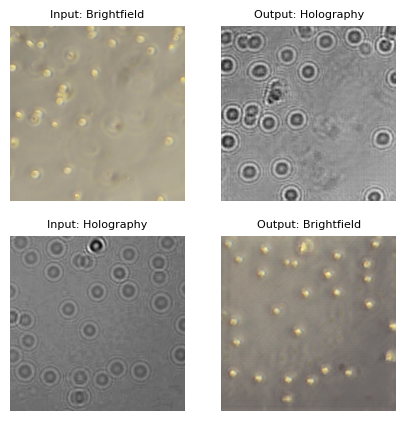


Epoch 78/100
----------
Batch 1/110 : Generators Loss: 1.9559, Discriminators Loss: 0.2699
Batch 21/110 : Generators Loss: 1.8474, Discriminators Loss: 0.2121
Batch 41/110 : Generators Loss: 1.8047, Discriminators Loss: 0.3092
Batch 61/110 : Generators Loss: 2.3870, Discriminators Loss: 0.1206
Batch 81/110 : Generators Loss: 2.0914, Discriminators Loss: 0.1344
Batch 101/110 : Generators Loss: 2.1836, Discriminators Loss: 0.1380
----------
Epoch 78/100 : Generators Loss: 2.0399, Discriminators Loss: 0.2195
Time taken: 0:06:22.945973


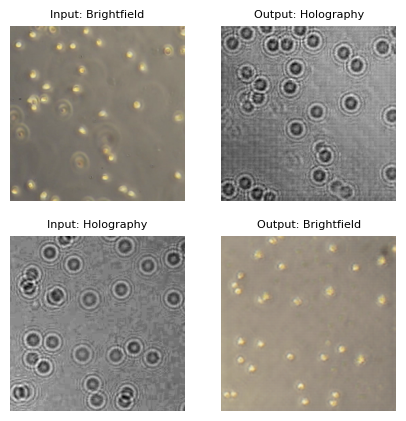


Epoch 79/100
----------
Batch 1/110 : Generators Loss: 2.0236, Discriminators Loss: 0.1824
Batch 21/110 : Generators Loss: 1.8840, Discriminators Loss: 0.2309
Batch 41/110 : Generators Loss: 1.9547, Discriminators Loss: 0.1718
Batch 61/110 : Generators Loss: 1.8934, Discriminators Loss: 0.2689
Batch 81/110 : Generators Loss: 1.8549, Discriminators Loss: 0.2478
Batch 101/110 : Generators Loss: 1.9352, Discriminators Loss: 0.1854
----------
Epoch 79/100 : Generators Loss: 1.9520, Discriminators Loss: 0.2301
Time taken: 0:06:22.663522


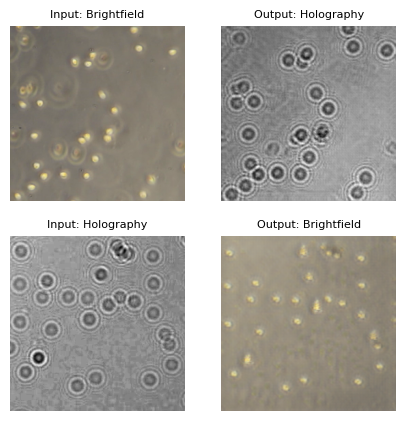


Epoch 80/100
----------
Batch 1/110 : Generators Loss: 1.8470, Discriminators Loss: 0.1858
Batch 21/110 : Generators Loss: 1.8598, Discriminators Loss: 0.2535
Batch 41/110 : Generators Loss: 2.0439, Discriminators Loss: 0.3012
Batch 61/110 : Generators Loss: 2.4694, Discriminators Loss: 0.1737
Batch 81/110 : Generators Loss: 2.2560, Discriminators Loss: 0.2252
Batch 101/110 : Generators Loss: 1.9041, Discriminators Loss: 0.1846
----------
Epoch 80/100 : Generators Loss: 1.9798, Discriminators Loss: 0.2358
Time taken: 0:06:22.554142


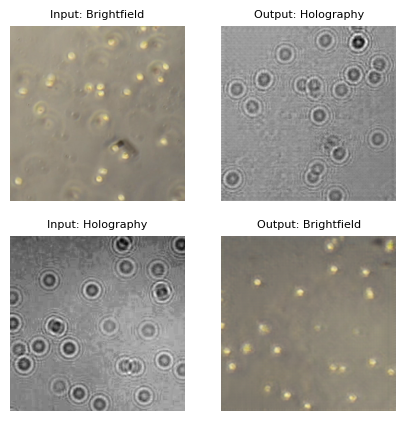


Epoch 81/100
----------
Batch 1/110 : Generators Loss: 1.8039, Discriminators Loss: 0.1999
Batch 21/110 : Generators Loss: 1.8386, Discriminators Loss: 0.2275
Batch 41/110 : Generators Loss: 2.0726, Discriminators Loss: 0.1993
Batch 61/110 : Generators Loss: 2.1227, Discriminators Loss: 0.2324
Batch 81/110 : Generators Loss: 1.9933, Discriminators Loss: 0.1719
Batch 101/110 : Generators Loss: 1.9752, Discriminators Loss: 0.2404
----------
Epoch 81/100 : Generators Loss: 1.9259, Discriminators Loss: 0.2227
Time taken: 0:06:22.614068


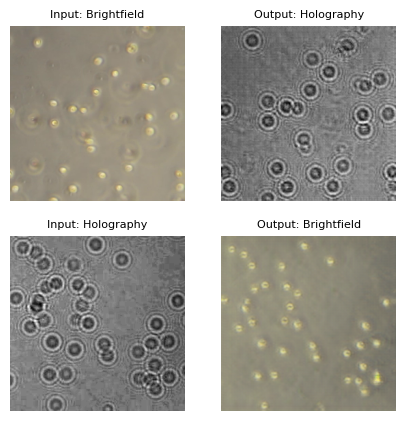


Epoch 82/100
----------
Batch 1/110 : Generators Loss: 1.9062, Discriminators Loss: 0.1915
Batch 21/110 : Generators Loss: 1.9635, Discriminators Loss: 0.1647
Batch 41/110 : Generators Loss: 1.9777, Discriminators Loss: 0.2368
Batch 61/110 : Generators Loss: 1.7523, Discriminators Loss: 0.2336
Batch 81/110 : Generators Loss: 1.9251, Discriminators Loss: 0.1741
Batch 101/110 : Generators Loss: 2.0056, Discriminators Loss: 0.2464
----------
Epoch 82/100 : Generators Loss: 1.9359, Discriminators Loss: 0.2284
Time taken: 0:06:22.651442


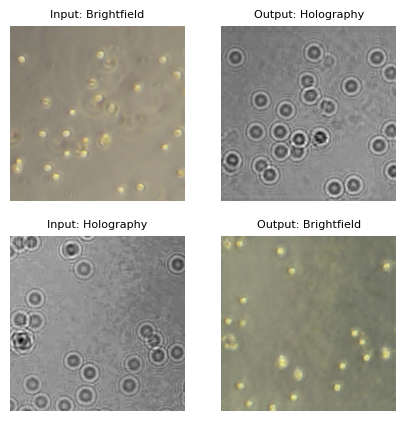


Epoch 83/100
----------
Batch 1/110 : Generators Loss: 1.9443, Discriminators Loss: 0.2127
Batch 21/110 : Generators Loss: 1.9951, Discriminators Loss: 0.2239
Batch 41/110 : Generators Loss: 1.8187, Discriminators Loss: 0.2209
Batch 61/110 : Generators Loss: 1.9251, Discriminators Loss: 0.2242
Batch 81/110 : Generators Loss: 1.9050, Discriminators Loss: 0.2252
Batch 101/110 : Generators Loss: 1.6339, Discriminators Loss: 0.2838
----------
Epoch 83/100 : Generators Loss: 1.9114, Discriminators Loss: 0.2389
Time taken: 0:06:22.575814


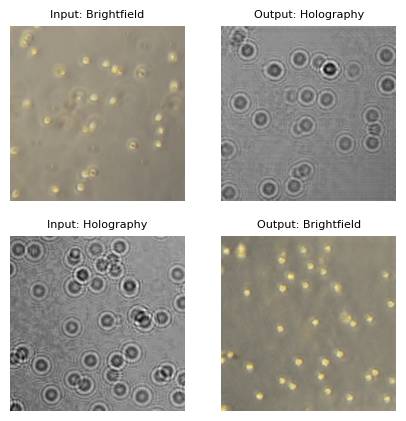


Epoch 84/100
----------
Batch 1/110 : Generators Loss: 1.9850, Discriminators Loss: 0.2366
Batch 21/110 : Generators Loss: 1.8573, Discriminators Loss: 0.2346
Batch 41/110 : Generators Loss: 1.8767, Discriminators Loss: 0.1889
Batch 61/110 : Generators Loss: 2.0097, Discriminators Loss: 0.3414
Batch 81/110 : Generators Loss: 1.7125, Discriminators Loss: 0.2348
Batch 101/110 : Generators Loss: 2.0355, Discriminators Loss: 0.1542
----------
Epoch 84/100 : Generators Loss: 1.8844, Discriminators Loss: 0.2412
Time taken: 0:06:21.895414


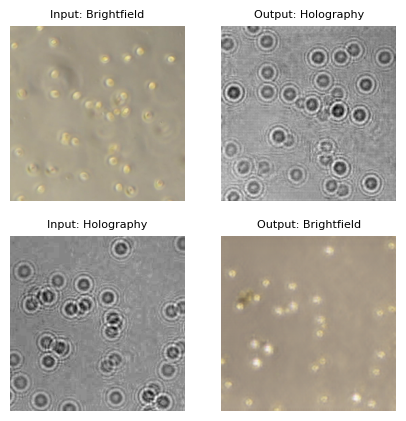


Epoch 85/100
----------
Batch 1/110 : Generators Loss: 2.1920, Discriminators Loss: 0.1486
Batch 21/110 : Generators Loss: 2.1041, Discriminators Loss: 0.1693
Batch 41/110 : Generators Loss: 2.0225, Discriminators Loss: 0.2556
Batch 61/110 : Generators Loss: 1.9238, Discriminators Loss: 0.1887
Batch 81/110 : Generators Loss: 2.1007, Discriminators Loss: 0.2416
Batch 101/110 : Generators Loss: 1.9969, Discriminators Loss: 0.1687
----------
Epoch 85/100 : Generators Loss: 1.9499, Discriminators Loss: 0.2102
Time taken: 0:06:24.110929


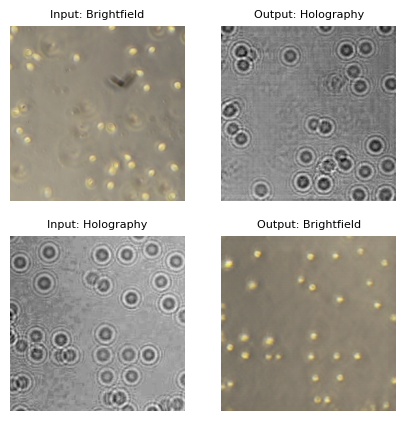


Epoch 86/100
----------
Batch 1/110 : Generators Loss: 1.9312, Discriminators Loss: 0.1832
Batch 21/110 : Generators Loss: 1.9688, Discriminators Loss: 0.2842
Batch 41/110 : Generators Loss: 2.0052, Discriminators Loss: 0.1367
Batch 61/110 : Generators Loss: 1.8697, Discriminators Loss: 0.1917
Batch 81/110 : Generators Loss: 1.8112, Discriminators Loss: 0.2375
Batch 101/110 : Generators Loss: 1.9085, Discriminators Loss: 0.2490
----------
Epoch 86/100 : Generators Loss: 1.9372, Discriminators Loss: 0.2138
Time taken: 0:06:23.530059


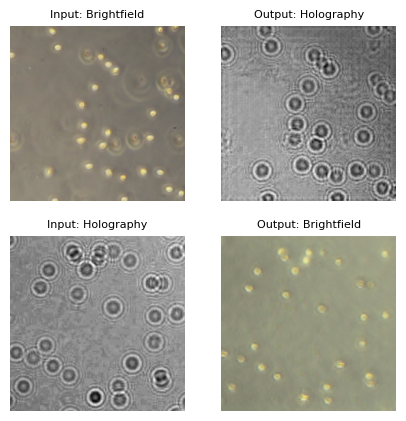


Epoch 87/100
----------
Batch 1/110 : Generators Loss: 1.8417, Discriminators Loss: 0.2357
Batch 21/110 : Generators Loss: 1.8235, Discriminators Loss: 0.2093
Batch 41/110 : Generators Loss: 1.8430, Discriminators Loss: 0.2522
Batch 61/110 : Generators Loss: 1.6772, Discriminators Loss: 0.2655
Batch 81/110 : Generators Loss: 1.9511, Discriminators Loss: 0.3019
Batch 101/110 : Generators Loss: 2.2432, Discriminators Loss: 0.1734
----------
Epoch 87/100 : Generators Loss: 1.8962, Discriminators Loss: 0.2210
Time taken: 0:06:22.761874


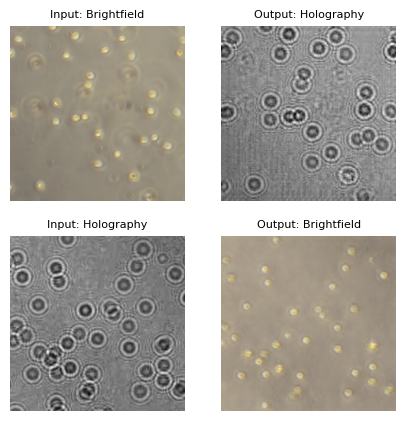


Epoch 88/100
----------
Batch 1/110 : Generators Loss: 2.0000, Discriminators Loss: 0.2592
Batch 21/110 : Generators Loss: 1.8215, Discriminators Loss: 0.3003
Batch 41/110 : Generators Loss: 1.9539, Discriminators Loss: 0.1850
Batch 61/110 : Generators Loss: 1.8323, Discriminators Loss: 0.2430
Batch 81/110 : Generators Loss: 1.9873, Discriminators Loss: 0.2048
Batch 101/110 : Generators Loss: 1.8615, Discriminators Loss: 0.2437
----------
Epoch 88/100 : Generators Loss: 1.9107, Discriminators Loss: 0.2120
Time taken: 0:06:22.807996


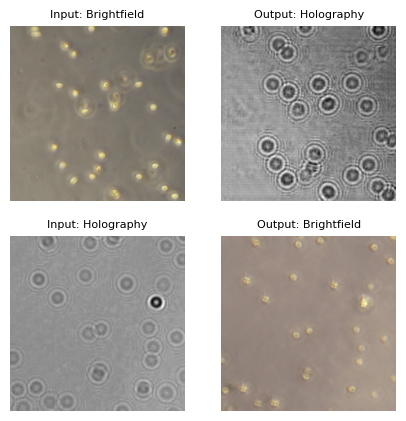


Epoch 89/100
----------
Batch 1/110 : Generators Loss: 1.8731, Discriminators Loss: 0.2335
Batch 21/110 : Generators Loss: 1.9156, Discriminators Loss: 0.1549
Batch 41/110 : Generators Loss: 1.8193, Discriminators Loss: 0.2741
Batch 61/110 : Generators Loss: 2.0463, Discriminators Loss: 0.2220
Batch 81/110 : Generators Loss: 1.8382, Discriminators Loss: 0.2388
Batch 101/110 : Generators Loss: 1.8906, Discriminators Loss: 0.2009
----------
Epoch 89/100 : Generators Loss: 1.8624, Discriminators Loss: 0.2158
Time taken: 0:06:22.674823


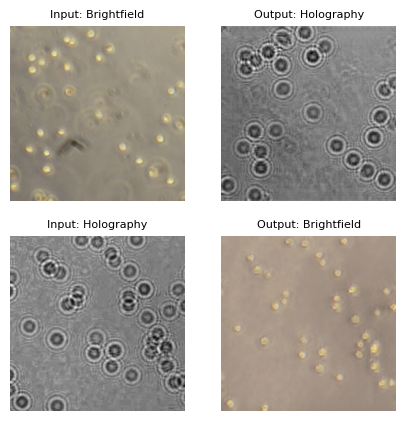


Epoch 90/100
----------
Batch 1/110 : Generators Loss: 1.6742, Discriminators Loss: 0.2236
Batch 21/110 : Generators Loss: 1.9281, Discriminators Loss: 0.1849
Batch 41/110 : Generators Loss: 1.8936, Discriminators Loss: 0.2072
Batch 61/110 : Generators Loss: 1.8727, Discriminators Loss: 0.2190
Batch 81/110 : Generators Loss: 1.8605, Discriminators Loss: 0.2399
Batch 101/110 : Generators Loss: 1.8759, Discriminators Loss: 0.2157
----------
Epoch 90/100 : Generators Loss: 1.8683, Discriminators Loss: 0.2116
Time taken: 0:06:22.764736


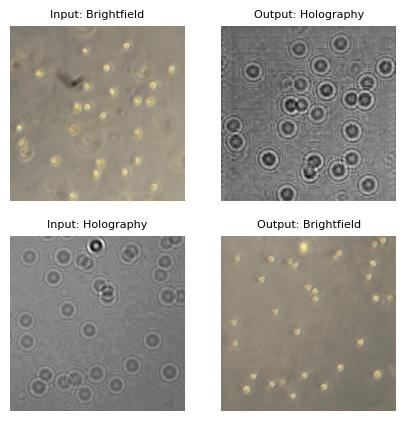


Epoch 91/100
----------
Batch 1/110 : Generators Loss: 1.7633, Discriminators Loss: 0.2933
Batch 21/110 : Generators Loss: 1.9277, Discriminators Loss: 0.1843
Batch 41/110 : Generators Loss: 1.8679, Discriminators Loss: 0.3293
Batch 61/110 : Generators Loss: 2.0578, Discriminators Loss: 0.1269
Batch 81/110 : Generators Loss: 1.9351, Discriminators Loss: 0.2904
Batch 101/110 : Generators Loss: 1.8175, Discriminators Loss: 0.2227
----------
Epoch 91/100 : Generators Loss: 1.8896, Discriminators Loss: 0.2490
Time taken: 0:06:22.761267


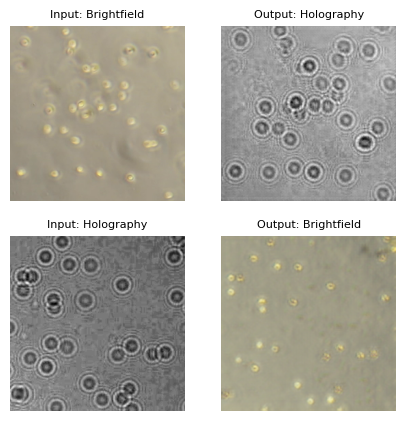


Epoch 92/100
----------
Batch 1/110 : Generators Loss: 1.9796, Discriminators Loss: 0.1913
Batch 21/110 : Generators Loss: 2.1945, Discriminators Loss: 0.3079
Batch 41/110 : Generators Loss: 1.9449, Discriminators Loss: 0.2073
Batch 61/110 : Generators Loss: 1.7692, Discriminators Loss: 0.1996
Batch 81/110 : Generators Loss: 1.7421, Discriminators Loss: 0.2321
Batch 101/110 : Generators Loss: 1.8991, Discriminators Loss: 0.1874
----------
Epoch 92/100 : Generators Loss: 1.8918, Discriminators Loss: 0.2274
Time taken: 0:06:22.740224


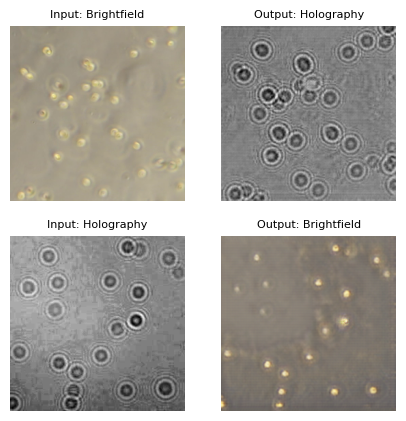


Epoch 93/100
----------
Batch 1/110 : Generators Loss: 1.7874, Discriminators Loss: 0.2349
Batch 21/110 : Generators Loss: 1.8645, Discriminators Loss: 0.1644
Batch 41/110 : Generators Loss: 1.8561, Discriminators Loss: 0.2348
Batch 61/110 : Generators Loss: 2.0183, Discriminators Loss: 0.2348
Batch 81/110 : Generators Loss: 1.8910, Discriminators Loss: 0.1956
Batch 101/110 : Generators Loss: 2.1291, Discriminators Loss: 0.2384
----------
Epoch 93/100 : Generators Loss: 1.9196, Discriminators Loss: 0.2171
Time taken: 0:06:22.650737


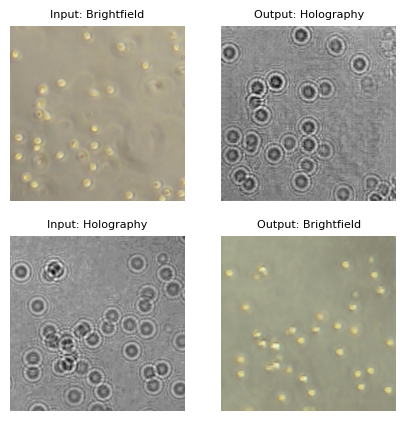


Epoch 94/100
----------
Batch 1/110 : Generators Loss: 1.8993, Discriminators Loss: 0.2296
Batch 21/110 : Generators Loss: 1.9384, Discriminators Loss: 0.3198
Batch 41/110 : Generators Loss: 1.9490, Discriminators Loss: 0.2032
Batch 61/110 : Generators Loss: 1.9446, Discriminators Loss: 0.1863
Batch 81/110 : Generators Loss: 1.8383, Discriminators Loss: 0.2546
Batch 101/110 : Generators Loss: 1.6716, Discriminators Loss: 0.2091
----------
Epoch 94/100 : Generators Loss: 1.8902, Discriminators Loss: 0.2109
Time taken: 0:06:23.200377


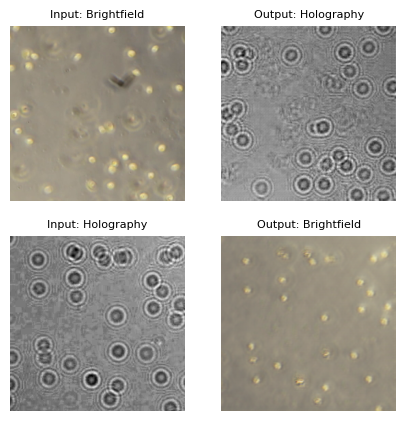


Epoch 95/100
----------
Batch 1/110 : Generators Loss: 1.6484, Discriminators Loss: 0.2559
Batch 21/110 : Generators Loss: 1.9283, Discriminators Loss: 0.1985
Batch 41/110 : Generators Loss: 1.8523, Discriminators Loss: 0.1848
Batch 61/110 : Generators Loss: 1.8828, Discriminators Loss: 0.2121
Batch 81/110 : Generators Loss: 1.7816, Discriminators Loss: 0.2133
Batch 101/110 : Generators Loss: 1.8636, Discriminators Loss: 0.1733
----------
Epoch 95/100 : Generators Loss: 1.8663, Discriminators Loss: 0.2138
Time taken: 0:06:24.411897


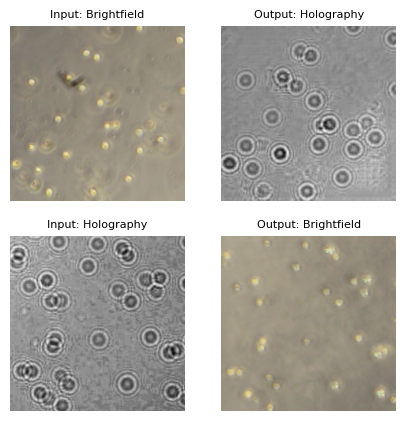


Epoch 96/100
----------
Batch 1/110 : Generators Loss: 1.7659, Discriminators Loss: 0.3175
Batch 21/110 : Generators Loss: 1.9341, Discriminators Loss: 0.1918
Batch 41/110 : Generators Loss: 1.8891, Discriminators Loss: 0.1403
Batch 61/110 : Generators Loss: 1.8081, Discriminators Loss: 0.2511
Batch 81/110 : Generators Loss: 1.7877, Discriminators Loss: 0.2069
Batch 101/110 : Generators Loss: 1.7485, Discriminators Loss: 0.2229
----------
Epoch 96/100 : Generators Loss: 1.8670, Discriminators Loss: 0.2127
Time taken: 0:06:22.811971


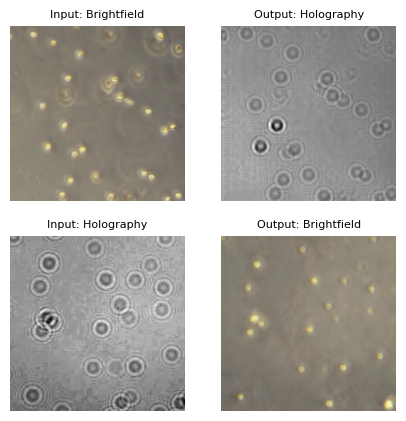


Epoch 97/100
----------
Batch 1/110 : Generators Loss: 1.7076, Discriminators Loss: 0.2947
Batch 21/110 : Generators Loss: 1.9404, Discriminators Loss: 0.1630
Batch 41/110 : Generators Loss: 1.7173, Discriminators Loss: 0.2425
Batch 61/110 : Generators Loss: 1.7562, Discriminators Loss: 0.2712
Batch 81/110 : Generators Loss: 2.1752, Discriminators Loss: 0.2455
Batch 101/110 : Generators Loss: 1.9705, Discriminators Loss: 0.1644
----------
Epoch 97/100 : Generators Loss: 1.8619, Discriminators Loss: 0.2126
Time taken: 0:06:22.656500


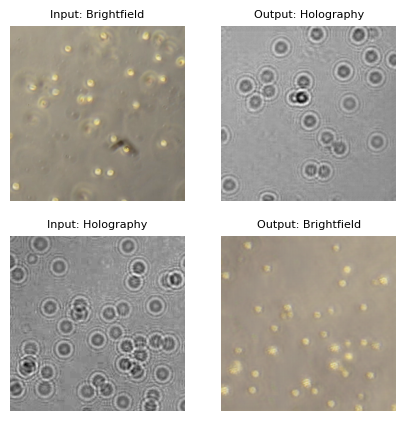


Epoch 98/100
----------
Batch 1/110 : Generators Loss: 1.7409, Discriminators Loss: 0.2262
Batch 21/110 : Generators Loss: 1.9853, Discriminators Loss: 0.1775
Batch 41/110 : Generators Loss: 1.8722, Discriminators Loss: 0.2241
Batch 61/110 : Generators Loss: 2.0105, Discriminators Loss: 0.2117
Batch 81/110 : Generators Loss: 1.8139, Discriminators Loss: 0.2779
Batch 101/110 : Generators Loss: 1.7260, Discriminators Loss: 0.2853
----------
Epoch 98/100 : Generators Loss: 1.9191, Discriminators Loss: 0.2116
Time taken: 0:06:22.578818


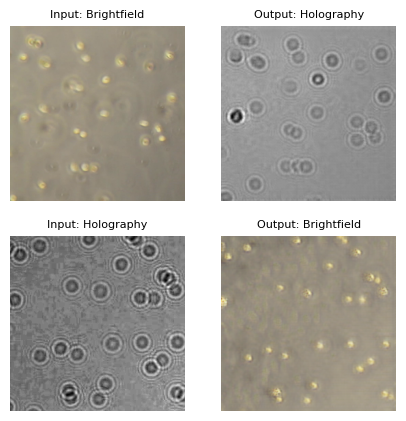


Epoch 99/100
----------
Batch 1/110 : Generators Loss: 1.8921, Discriminators Loss: 0.1743
Batch 21/110 : Generators Loss: 2.0327, Discriminators Loss: 0.1235
Batch 41/110 : Generators Loss: 1.8599, Discriminators Loss: 0.1839
Batch 61/110 : Generators Loss: 1.7388, Discriminators Loss: 0.2838
Batch 81/110 : Generators Loss: 1.9794, Discriminators Loss: 0.1805
Batch 101/110 : Generators Loss: 1.9920, Discriminators Loss: 0.1341
----------
Epoch 99/100 : Generators Loss: 1.8823, Discriminators Loss: 0.2077
Time taken: 0:06:22.534213


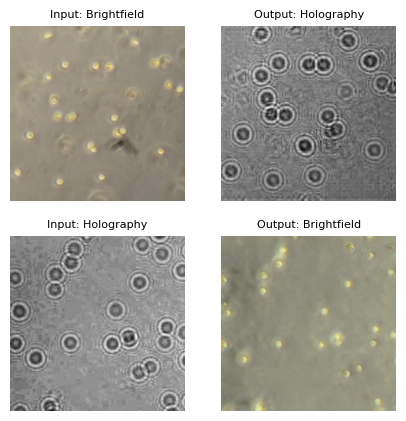


Epoch 100/100
----------
Batch 1/110 : Generators Loss: 1.8688, Discriminators Loss: 0.2194
Batch 21/110 : Generators Loss: 2.0134, Discriminators Loss: 0.1409
Batch 41/110 : Generators Loss: 1.9543, Discriminators Loss: 0.3176
Batch 61/110 : Generators Loss: 2.1115, Discriminators Loss: 0.2381
Batch 81/110 : Generators Loss: 1.9692, Discriminators Loss: 0.2438
Batch 101/110 : Generators Loss: 1.8580, Discriminators Loss: 0.2627
----------
Epoch 100/100 : Generators Loss: 1.8938, Discriminators Loss: 0.2098
Time taken: 0:06:22.491297


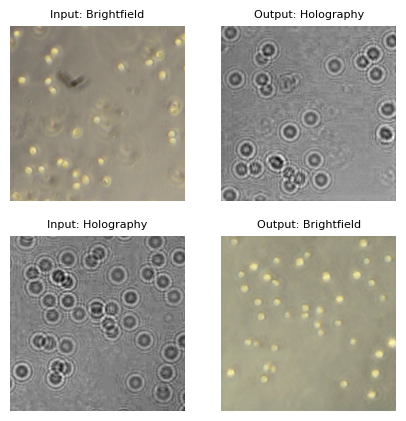

In [15]:
import time
from datetime import timedelta

epochs = 100

gen_losses, disc_losses = [], []
for epoch in range(epochs):
    start_time = time.time()
    print("\n" + f"Epoch {epoch + 1}/{epochs}" + "\n" + "-" * 10)

    gen_losses_epoch, disc_losses_epoch = [], []
    for i, (inputs_H, inputs_B) in enumerate(train_loader, 0):
        inputs_H, inputs_B = inputs_H.to(device), inputs_B.to(device)
        disc_loss, gen_loss = train_model(
            inputs_H, inputs_B, optim_disc, optim_gen, loss_disc, loss_gen,
        )

        if i % 20 == 0:
            print(f"Batch {i + 1}/{len(train_loader)} : "
                  f"Generators Loss: {gen_loss.item():.4f}, "
                  f"Discriminators Loss: {disc_loss.item():.4f}")

        gen_losses_epoch.append(gen_loss.item())
        disc_losses_epoch.append(disc_loss.item())

    end_time = time.time()

    gen_losses.append(np.mean(gen_losses_epoch))
    disc_losses.append(np.mean(disc_losses_epoch))

    print("-" * 10 + "\n" + f"Epoch {epoch + 1}/{epochs} : "
          f"Generators Loss: {gen_losses[-1]:.4f}, "
          f"Discriminators Loss: {disc_losses[-1]:.4f}"
          "\n" + f"Time taken: {timedelta(seconds=end_time - start_time)}")

    for test_inputs_H, test_inputs_B in test_loader:
        break
    evaluate_model(test_inputs_H.to(device), test_inputs_B.to(device))